In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence

import torchvision
from torchvision import transforms, models

import pandas as pd
import numpy as np
from pathlib import Path
from collections import Counter
from tqdm import tqdm
import matplotlib.pyplot as plt
from PIL import Image
import pickle
import json

# Configuration GPU/CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device utilisé: {device}")

if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)}")
    print(f"Mémoire disponible: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")

# Seed pour reproductibilité
SEED = 42
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
np.random.seed(SEED)

print("\n✅ Imports et configuration terminés!")

Device utilisé: cuda
GPU: NVIDIA RTX 6000 Ada Generation
Mémoire disponible: 50.99 GB

✅ Imports et configuration terminés!


In [10]:
# ============= CHEMINS =============
TRAIN_DIR = "./outputs/train"
VAL_DIR = "./outputs/val"
TEST_DIR = "./outputs/test"

TRAIN_CAPTIONS = "./outputs/train_captions.csv"
VAL_CAPTIONS = "./outputs/val_captions.csv"
TEST_CAPTIONS = "./outputs/test_captions.csv"

SEPARATOR = '|'  # Séparateur du CSV

# Dossier pour sauvegarder les résultats
OUTPUT_DIR = Path("outputs")
OUTPUT_DIR.mkdir(exist_ok=True)

MODEL_SAVE_PATH = OUTPUT_DIR / "best_model.pth"
VOCAB_SAVE_PATH = OUTPUT_DIR / "vocabulary.pkl"
CONFIG_SAVE_PATH = OUTPUT_DIR / "config.json"

# ============= HYPERPARAMÈTRES =============
EMBED_DIM = 256        # Dimension des embeddings
HIDDEN_DIM = 512     # Dimension cachée du LSTM
NUM_LAYERS = 1         # Nombre de couches LSTM
DROPOUT = 0.5          # Dropout

BATCH_SIZE = 64        # Taille du batch
LEARNING_RATE = 1e-3   # Learning rate
NUM_EPOCHS = 40        # Nombre d'epochs

# Tokens spéciaux
PAD_TOKEN = '<PAD>'
START_TOKEN = '<START>'
END_TOKEN = '<END>'
UNK_TOKEN = '<UNK>'

# Vocabulaire
MIN_WORD_FREQ = 5      # Fréquence minimale pour inclure un mot
MAX_CAPTION_LENGTH = 50  # Longueur max des captions

print("Configuration:")
print(f"  - Device: {device}")
print(f"  - Embedding dim: {EMBED_DIM}")
print(f"  - Hidden dim: {HIDDEN_DIM}")
print(f"  - Batch size: {BATCH_SIZE}")
print(f"  - Learning rate: {LEARNING_RATE}")
print(f"  - Epochs: {NUM_EPOCHS}")
print(f"\n✅ Configuration terminée!")

Configuration:
  - Device: cuda
  - Embedding dim: 256
  - Hidden dim: 512
  - Batch size: 64
  - Learning rate: 0.001
  - Epochs: 40

✅ Configuration terminée!


In [11]:
class Vocabulary:
    """Classe pour gérer le vocabulaire et la tokenization"""
    
    def __init__(self, min_freq=5):
        self.min_freq = min_freq
        self.word2idx = {}
        self.idx2word = {}
        self.word_freq = Counter()
        
        # Initialiser avec tokens spéciaux
        self.special_tokens = [PAD_TOKEN, START_TOKEN, END_TOKEN, UNK_TOKEN]
        for idx, token in enumerate(self.special_tokens):
            self.word2idx[token] = idx
            self.idx2word[idx] = token
    
    def build_vocab(self, captions_list):
        """Construit le vocabulaire à partir d'une liste de captions"""
        print("Construction du vocabulaire...")
        
        # Compter les fréquences
        for caption in tqdm(captions_list, desc="Comptage des mots"):
            tokens = self._tokenize(caption)
            self.word_freq.update(tokens)
        
        # Ajouter les mots qui dépassent le seuil de fréquence
        idx = len(self.special_tokens)
        for word, freq in self.word_freq.items():
            if freq >= self.min_freq:
                if word not in self.word2idx:
                    self.word2idx[word] = idx
                    self.idx2word[idx] = word
                    idx += 1
        
        print(f"✅ Vocabulaire construit!")
        print(f"  - Taille du vocabulaire: {len(self.word2idx)}")
        print(f"  - Mots uniques trouvés: {len(self.word_freq)}")
        print(f"  - Mots gardés (freq >= {self.min_freq}): {len(self.word2idx) - len(self.special_tokens)}")
    
    def _tokenize(self, caption):
        """Tokenize une caption en mots"""
        # Convertir en minuscules et split
        caption = caption.lower().strip()
        # Enlever la ponctuation et split
        tokens = caption.replace('.', '').replace(',', '').replace('!', '').replace('?', '').split()
        return tokens
    
    def encode(self, caption):
        """Convertit une caption en liste d'indices"""
        tokens = self._tokenize(caption)
        indices = [self.word2idx[START_TOKEN]]
        
        for token in tokens:
            if token in self.word2idx:
                indices.append(self.word2idx[token])
            else:
                indices.append(self.word2idx[UNK_TOKEN])
        
        indices.append(self.word2idx[END_TOKEN])
        return indices
    
    def decode(self, indices, skip_special=True):
        """Convertit une liste d'indices en caption"""
        words = []
        for idx in indices:
            word = self.idx2word.get(idx, UNK_TOKEN)
            if skip_special and word in self.special_tokens:
                if word == END_TOKEN:
                    break
                continue
            words.append(word)
        return ' '.join(words)
    
    def __len__(self):
        return len(self.word2idx)
    
    def save(self, filepath):
        """Sauvegarde le vocabulaire"""
        with open(filepath, 'wb') as f:
            pickle.dump({
                'word2idx': self.word2idx,
                'idx2word': self.idx2word,
                'word_freq': self.word_freq,
                'min_freq': self.min_freq
            }, f)
        print(f"✅ Vocabulaire sauvegardé: {filepath}")
    
    @classmethod
    def load(cls, filepath):
        """Charge un vocabulaire sauvegardé"""
        with open(filepath, 'rb') as f:
            data = pickle.load(f)
        
        vocab = cls(min_freq=data['min_freq'])
        vocab.word2idx = data['word2idx']
        vocab.idx2word = data['idx2word']
        vocab.word_freq = data['word_freq']
        
        print(f"✅ Vocabulaire chargé: {filepath}")
        print(f"  - Taille: {len(vocab)}")
        return vocab

print("✅ Classe Vocabulary définie!")

✅ Classe Vocabulary définie!


In [12]:
# Charger toutes les captions du train
print("Chargement des captions d'entraînement...")
train_df = pd.read_csv(TRAIN_CAPTIONS, sep=SEPARATOR)
all_captions = train_df['caption'].tolist()

print(f"Total captions: {len(all_captions)}")
print(f"\nExemples de captions:")
for i in range(3):
    print(f"  {i+1}. {all_captions[i]}")

# Créer et construire le vocabulaire
vocab = Vocabulary(min_freq=MIN_WORD_FREQ)
vocab.build_vocab(all_captions)

# Afficher les mots les plus fréquents
print(f"\n10 mots les plus fréquents:")
for word, freq in vocab.word_freq.most_common(10):
    print(f"  - '{word}': {freq} fois")

# Tester l'encodage/décodage
test_caption = all_captions[0]
print(f"\nTest encodage/décodage:")
print(f"Original: {test_caption}")
encoded = vocab.encode(test_caption)
print(f"Encodé: {encoded[:10]}... (longueur: {len(encoded)})")
decoded = vocab.decode(encoded)
print(f"Décodé: {decoded}")

# Sauvegarder le vocabulaire
vocab.save(VOCAB_SAVE_PATH)

# Stocker vocab_size pour plus tard
VOCAB_SIZE = len(vocab)
PAD_IDX = vocab.word2idx[PAD_TOKEN]
START_IDX = vocab.word2idx[START_TOKEN]
END_IDX = vocab.word2idx[END_TOKEN]

print(f"\n✅ Vocabulaire prêt!")
print(f"  - PAD_IDX: {PAD_IDX}")
print(f"  - START_IDX: {START_IDX}")
print(f"  - END_IDX: {END_IDX}")

Chargement des captions d'entraînement...
Total captions: 32360

Exemples de captions:
  1. A child in a pink dress is climbing up a set of stairs in an entry way .
  2. A girl going into a wooden building .
  3. A little girl climbing into a wooden playhouse .
Construction du vocabulaire...


Comptage des mots: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████| 32360/32360 [00:00<00:00, 667928.16it/s]

✅ Vocabulaire construit!
  - Taille du vocabulaire: 2660
  - Mots uniques trouvés: 8088
  - Mots gardés (freq >= 5): 2656

10 mots les plus fréquents:
  - 'a': 50185 fois
  - 'in': 15200 fois
  - 'the': 14757 fois
  - 'on': 8540 fois
  - 'is': 7365 fois
  - 'and': 7131 fois
  - 'dog': 6393 fois
  - 'with': 6266 fois
  - 'man': 5886 fois
  - 'of': 5406 fois

Test encodage/décodage:
Original: A child in a pink dress is climbing up a set of stairs in an entry way .
Encodé: [1, 4, 5, 6, 4, 7, 8, 9, 10, 11]... (longueur: 19)
Décodé: a child in a pink dress is climbing up a set of stairs in an way
✅ Vocabulaire sauvegardé: outputs/vocabulary.pkl

✅ Vocabulaire prêt!
  - PAD_IDX: 0
  - START_IDX: 1
  - END_IDX: 2


In [13]:
class Flickr8kCaptionDataset(Dataset):
    """Dataset pour charger images + captions tokenizées"""
    
    def __init__(self, images_dir, captions_file, vocab, separator='|', max_length=50):
        """
        Args:
            images_dir: Dossier avec les tenseurs .pt
            captions_file: Fichier CSV avec captions
            vocab: Instance de Vocabulary
            separator: Séparateur du CSV
            max_length: Longueur max des captions
        """
        self.images_dir = Path(images_dir)
        self.captions_df = pd.read_csv(captions_file, sep=separator)
        self.vocab = vocab
        self.max_length = max_length
        
        print(f"Dataset chargé: {len(self.captions_df)} captions")
    
    def __len__(self):
        return len(self.captions_df)
    
    def __getitem__(self, idx):
        """Retourne (image_tensor, caption_indices, caption_length)"""
        # Récupérer caption
        row = self.captions_df.iloc[idx]
        image_name = row['image']
        caption = row['caption']
        
        # Charger le tenseur de l'image
        image_filename = image_name.split('.')[0] + '.pt'
        image_path = self.images_dir / image_filename
        image_tensor = torch.load(image_path)
        
        # Encoder la caption
        caption_indices = self.vocab.encode(caption)
        
        # Limiter la longueur
        if len(caption_indices) > self.max_length:
            caption_indices = caption_indices[:self.max_length]
        
        caption_length = len(caption_indices)
        
        return image_tensor, caption_indices, caption_length

print("✅ Classe Flickr8kCaptionDataset définie!")

✅ Classe Flickr8kCaptionDataset définie!


In [14]:
def collate_fn(batch):
    """
    Fonction pour créer des batches avec padding
    
    Args:
        batch: Liste de tuples (image, caption_indices, length)
    
    Returns:
        images: Tensor [batch_size, 3, 224, 224]
        captions: Tensor [batch_size, max_length] (paddé)
        lengths: Tensor [batch_size] (longueurs originales)
    """
    # Séparer les composants
    images = [item[0] for item in batch]
    captions = [item[1] for item in batch]
    lengths = [item[2] for item in batch]
    
    # Stack les images (déjà même taille)
    images = torch.stack(images, 0)
    
    # Trouver la longueur max dans ce batch
    max_length = max(lengths)
    
    # Padding des captions
    padded_captions = []
    for cap in captions:
        # Ajouter des PAD_IDX jusqu'à max_length
        pad_length = max_length - len(cap)
        padded = cap + [PAD_IDX] * pad_length
        padded_captions.append(padded)
    
    # Convertir en tenseurs
    captions_tensor = torch.LongTensor(padded_captions)
    lengths_tensor = torch.LongTensor(lengths)
    
    # Trier par longueur décroissante (requis pour pack_padded_sequence)
    lengths_tensor, sort_idx = lengths_tensor.sort(descending=True)
    images = images[sort_idx]
    captions_tensor = captions_tensor[sort_idx]
    
    return images, captions_tensor, lengths_tensor

print("✅ Fonction collate_fn définie!")

✅ Fonction collate_fn définie!


In [15]:
# Créer les datasets
print("Création des datasets...")
train_dataset = Flickr8kCaptionDataset(
    images_dir=TRAIN_DIR,
    captions_file=TRAIN_CAPTIONS,
    vocab=vocab,
    separator=SEPARATOR,
    max_length=MAX_CAPTION_LENGTH
)

val_dataset = Flickr8kCaptionDataset(
    images_dir=VAL_DIR,
    captions_file=VAL_CAPTIONS,
    vocab=vocab,
    separator=SEPARATOR,
    max_length=MAX_CAPTION_LENGTH
)

test_dataset = Flickr8kCaptionDataset(
    images_dir=TEST_DIR,
    captions_file=TEST_CAPTIONS,
    vocab=vocab,
    separator=SEPARATOR,
    max_length=MAX_CAPTION_LENGTH
)

# Créer les DataLoaders
print("\nCréation des DataLoaders...")
train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=4,
    collate_fn=collate_fn,
    pin_memory=True if torch.cuda.is_available() else False
)

val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=4,
    collate_fn=collate_fn,
    pin_memory=True if torch.cuda.is_available() else False
)

test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=4,
    collate_fn=collate_fn,
    pin_memory=True if torch.cuda.is_available() else False
)

print(f"\n✅ DataLoaders créés!")
print(f"  - Train: {len(train_loader)} batches ({len(train_dataset)} exemples)")
print(f"  - Val: {len(val_loader)} batches ({len(val_dataset)} exemples)")
print(f"  - Test: {len(test_loader)} batches ({len(test_dataset)} exemples)")

# Tester un batch
print("\nTest d'un batch:")
for images, captions, lengths in train_loader:
    print(f"  - Images shape: {images.shape}")
    print(f"  - Captions shape: {captions.shape}")
    print(f"  - Lengths shape: {lengths.shape}")
    print(f"  - Première caption (indices): {captions[0][:10].tolist()}...")
    print(f"  - Première caption (décodée): {vocab.decode(captions[0].tolist())}")
    break

Création des datasets...
Dataset chargé: 32360 captions
Dataset chargé: 4045 captions
Dataset chargé: 4050 captions

Création des DataLoaders...

✅ DataLoaders créés!
  - Train: 506 batches (32360 exemples)
  - Val: 64 batches (4045 exemples)
  - Test: 64 batches (4050 exemples)

Test d'un batch:
  - Images shape: torch.Size([64, 3, 224, 224])
  - Captions shape: torch.Size([64, 19])
  - Lengths shape: torch.Size([64])
  - Première caption (indices): [1, 24, 17, 6, 4, 208, 152, 260, 6, 57]...
  - Première caption (décodée): the girl in a yellow shirt walks in front of a group of kids holding up


In [16]:
class EncoderCNN(nn.Module):
    """Encoder basé sur VGG16 pré-entraîné (gelé) + couche de projection"""
    
    def __init__(self, embed_dim):
        """
        Args:
            embed_dim: Dimension de sortie de la projection
        """
        super(EncoderCNN, self).__init__()
        
        # Charger VGG16 pré-entraîné
        vgg16 = models.vgg16(pretrained=True)
        
        # Garder seulement les features (conv layers)
        self.features = vgg16.features
        
        # Geler tous les paramètres du VGG16
        for param in self.features.parameters():
            param.requires_grad = False
        
        # Global Average Pooling
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        
        # Couche de projection: 512 (VGG16 output) → embed_dim
        self.projection = nn.Sequential(
            nn.Linear(512, embed_dim),
            nn.ReLU(),
            nn.Dropout(DROPOUT)
        )
    
    def forward(self, images):
        """
        Args:
            images: Tensor [batch_size, 3, 224, 224]
        
        Returns:
            features: Tensor [batch_size, embed_dim]
        """
        # Extract features avec VGG16
        with torch.no_grad():  # Pas de gradient pour VGG16
            features = self.features(images)  # [batch, 512, 7, 7]
        
        # Global Average Pooling
        features = self.avgpool(features)  # [batch, 512, 1, 1]
        features = features.view(features.size(0), -1)  # [batch, 512]
        
        # Projection
        features = self.projection(features)  # [batch, embed_dim]
        
        return features

print("✅ Classe EncoderCNN définie!")

✅ Classe EncoderCNN définie!


In [17]:
class DecoderRNN(nn.Module):
    """Decoder LSTM pour générer les captions"""
    
    def __init__(self, embed_dim, hidden_dim, vocab_size, num_layers=1, dropout=0.5):
        """
        Args:
            embed_dim: Dimension des embeddings
            hidden_dim: Dimension cachée du LSTM
            vocab_size: Taille du vocabulaire
            num_layers: Nombre de couches LSTM
            dropout: Dropout rate
        """
        super(DecoderRNN, self).__init__()
        
        self.embed_dim = embed_dim
        self.hidden_dim = hidden_dim
        self.vocab_size = vocab_size
        self.num_layers = num_layers
        
        # Embedding layer pour les mots
        self.embedding = nn.Embedding(vocab_size, embed_dim, padding_idx=PAD_IDX)
        
        # LSTM
        self.lstm = nn.LSTM(
            input_size=embed_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            dropout=dropout if num_layers > 1 else 0,
            batch_first=True
        )
        
        # Couche finale: hidden_dim → vocab_size
        self.fc = nn.Linear(hidden_dim, vocab_size)
        
        # Dropout
        self.dropout = nn.Dropout(dropout)
    
    def forward(self, features, captions, lengths):
        """
        Args:
            features: Tensor [batch_size, embed_dim] (from encoder)
            captions: Tensor [batch_size, max_length] (caption indices)
            lengths: Tensor [batch_size] (longueurs des captions)
        
        Returns:
            outputs: Tensor [batch_size, max_length, vocab_size]
        """
        # Embedding des captions
        embeddings = self.embedding(captions)  # [batch, max_length, embed_dim]
        embeddings = self.dropout(embeddings)
        
        # Initialiser l'état caché avec les features de l'image
        # features: [batch, embed_dim] → need [num_layers, batch, hidden_dim]
        batch_size = features.size(0)
        
        # Projection des features pour initialiser h0
        h0 = features.unsqueeze(0)  # [1, batch, embed_dim]
        
        # Si embed_dim != hidden_dim, on fait une projection
        if self.embed_dim != self.hidden_dim:
            # Créer une projection temporaire
            if not hasattr(self, 'feature_projection'):
                self.feature_projection = nn.Linear(self.embed_dim, self.hidden_dim).to(features.device)
            h0 = self.feature_projection(h0.squeeze(0)).unsqueeze(0)
        
        # Répéter pour num_layers
        h0 = h0.repeat(self.num_layers, 1, 1)  # [num_layers, batch, hidden_dim]
        c0 = torch.zeros_like(h0)  # État de cellule initialisé à zéro
        
        # Pack padded sequence pour efficacité
        packed_embeddings = pack_padded_sequence(
            embeddings, 
            lengths.cpu(), 
            batch_first=True,
            enforce_sorted=True
        )
        
        # LSTM forward
        packed_outputs, _ = self.lstm(packed_embeddings, (h0, c0))
        
        # Unpack
        outputs, _ = pad_packed_sequence(packed_outputs, batch_first=True)
        
        # Projection vers vocab_size
        outputs = self.fc(outputs)  # [batch, max_length, vocab_size]
        
        return outputs

print("✅ Classe DecoderRNN définie!")

✅ Classe DecoderRNN définie!


In [18]:
class CaptionModel(nn.Module):
    def __init__(self, embed_dim, hidden_dim, vocab_size, num_layers=1, dropout=0.5):
        super().__init__()
        
        self.embed_dim = embed_dim
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        # Encoder CNN
        self.encoder = EncoderCNN(embed_dim)
        
        # ✅ AJOUT : Projection entraînable features → hidden state
        if embed_dim != hidden_dim:
            self.feature_to_hidden = nn.Linear(embed_dim, hidden_dim)
        
        # Embedding des mots
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        
        # Decoder LSTM
        self.lstm = nn.LSTM(
            input_size=embed_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout if num_layers > 1 else 0
        )
        
        # Couche de sortie
        self.fc = nn.Linear(hidden_dim, vocab_size)
        self.dropout = nn.Dropout(dropout)
    
    def forward(self, images, captions, lengths=None):  # ← CORRECTION ICI
        """
        Args:
            images: [batch_size, 3, 224, 224]
            captions: [batch_size, seq_len]
            lengths: [batch_size] (optionnel, non utilisé)
        Returns:
            outputs: [batch_size, seq_len, vocab_size]
        """
        # Encoder les images
        features = self.encoder(images)  # [batch, embed_dim]
        
        # ✅ MODIFICATION : Initialiser hidden state avec projection
        batch_size = features.size(0)
        if hasattr(self, 'feature_to_hidden'):
            h = self.feature_to_hidden(features)  # [batch, hidden_dim]
        else:
            h = features  # [batch, embed_dim] (si embed_dim == hidden_dim)
        
        h = h.unsqueeze(0).repeat(self.num_layers, 1, 1)  # [num_layers, batch, hidden_dim]
        c = torch.zeros_like(h)
        
        # Embeddings des captions
        embeds = self.embedding(captions)  # [batch, seq_len, embed_dim]
        embeds = self.dropout(embeds)
        
        # LSTM
        lstm_out, _ = self.lstm(embeds, (h, c))  # [batch, seq_len, hidden_dim]
        
        # Prédictions
        outputs = self.fc(lstm_out)  # [batch, seq_len, vocab_size]
        
        return outputs

In [19]:
# Créer le modèle
print("Création du modèle...")
model = CaptionModel(
    embed_dim=EMBED_DIM,
    hidden_dim=HIDDEN_DIM,
    vocab_size=VOCAB_SIZE,
    num_layers=NUM_LAYERS,
    dropout=DROPOUT
)

# Déplacer vers GPU/CPU
model = model.to(device)

# Compter les paramètres
def count_parameters(model):
    trainable = sum(p.numel() for p in model.parameters() if p.requires_grad)
    frozen = sum(p.numel() for p in model.parameters() if not p.requires_grad)
    return trainable, frozen

trainable_params, frozen_params = count_parameters(model)

print(f"\n✅ Modèle créé et déplacé vers {device}!")
print(f"\nArchitecture:")
print(model)
print(f"\nParamètres:")
print(f"  - Entraînables: {trainable_params:,}")
print(f"  - Gelés (VGG16): {frozen_params:,}")
print(f"  - Total: {trainable_params + frozen_params:,}")

# Afficher les couches entraînables
print(f"\nCouches entraînables:")
for name, param in model.named_parameters():
    if param.requires_grad:
        print(f"  - {name}: {param.numel():,} params")

Création du modèle...


/opt/venvs/deepeirb/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/venvs/deepeirb/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



✅ Modèle créé et déplacé vers cuda!

Architecture:
CaptionModel(
  (encoder): EncoderCNN(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(

In [20]:
# Loss function
criterion = nn.CrossEntropyLoss(ignore_index=PAD_IDX)

# Optimizer (seulement sur les paramètres entraînables)
optimizer = optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()),
    lr=LEARNING_RATE
)

# Learning rate scheduler (optionnel)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, 
    mode='min', 
    factor=0.5, 
    patience=3
    # verbose retiré (n'existe plus dans PyTorch récent)
)

print("✅ Loss, Optimizer et Scheduler créés!")
print(f"  - Criterion: CrossEntropyLoss (ignore_index={PAD_IDX})")
print(f"  - Optimizer: Adam (lr={LEARNING_RATE})")
print(f"  - Scheduler: ReduceLROnPlateau (factor=0.5, patience=3)")

✅ Loss, Optimizer et Scheduler créés!
  - Criterion: CrossEntropyLoss (ignore_index=0)
  - Optimizer: Adam (lr=0.001)
  - Scheduler: ReduceLROnPlateau (factor=0.5, patience=3)


In [21]:
def train_epoch(model, dataloader, criterion, optimizer, device):
    """
    Entraîne le modèle pour une epoch
    
    Returns:
        avg_loss: Loss moyenne sur l'epoch
    """
    model.train()
    total_loss = 0
    
    progress_bar = tqdm(dataloader, desc="Training")
    
    for images, captions, lengths in progress_bar:
        # Déplacer vers device
        images = images.to(device)
        captions = captions.to(device)
        lengths = lengths.to(device)
        
        # Forward pass
        optimizer.zero_grad()
        outputs = model(images, captions, lengths)
        
        # Calculer la loss
        # outputs: [batch, max_length, vocab_size]
        # captions: [batch, max_length]
        # On prédit captions[:, 1:] à partir de captions[:, :-1]
        
        # Reshape pour CrossEntropyLoss
        outputs = outputs[:, :-1, :].contiguous()  # Enlever le dernier timestep
        targets = captions[:, 1:].contiguous()      # Enlever <START>
        
        outputs = outputs.view(-1, VOCAB_SIZE)  # [batch * (max_length-1), vocab_size]
        targets = targets.view(-1)               # [batch * (max_length-1)]
        
        loss = criterion(outputs, targets)
        
        # Backward pass
        loss.backward()
        
        # Gradient clipping (éviter l'explosion des gradients)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        
        optimizer.step()
        
        # Accumuler la loss
        total_loss += loss.item()
        
        # Mettre à jour la progress bar
        progress_bar.set_postfix({'loss': loss.item()})
    
    avg_loss = total_loss / len(dataloader)
    return avg_loss

print("✅ Fonction train_epoch définie!")

✅ Fonction train_epoch définie!


In [22]:
def validate(model, dataloader, criterion, device):
    """
    Évalue le modèle sur le validation set
    
    Returns:
        avg_loss: Loss moyenne
        perplexity: Perplexité
    """
    model.eval()
    total_loss = 0
    
    with torch.no_grad():
        progress_bar = tqdm(dataloader, desc="Validation")
        
        for images, captions, lengths in progress_bar:
            # Déplacer vers device
            images = images.to(device)
            captions = captions.to(device)
            lengths = lengths.to(device)
            
            # Forward pass
            outputs = model(images, captions, lengths)
            
            # Calculer la loss
            outputs = outputs[:, :-1, :].contiguous()
            targets = captions[:, 1:].contiguous()
            
            outputs = outputs.view(-1, VOCAB_SIZE)
            targets = targets.view(-1)
            
            loss = criterion(outputs, targets)
            
            total_loss += loss.item()
            
            progress_bar.set_postfix({'loss': loss.item()})
    
    avg_loss = total_loss / len(dataloader)
    perplexity = np.exp(avg_loss)
    
    return avg_loss, perplexity

print("✅ Fonction validate définie!")

✅ Fonction validate définie!


In [23]:
# Historique pour les plots
history = {
    'train_loss': [],
    'val_loss': [],
    'val_perplexity': []
}

best_val_loss = float('inf')
patience_counter = 0
early_stop_patience = 5

print("="*60)
print("DÉBUT DE L'ENTRAÎNEMENT")
print("="*60)

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"\n{'='*60}")
    print(f"Epoch {epoch}/{NUM_EPOCHS}")
    print(f"{'='*60}")
    
    # Entraînement
    train_loss = train_epoch(model, train_loader, criterion, optimizer, device)
    
    # Validation
    val_loss, val_perplexity = validate(model, val_loader, criterion, device)
    
    # Sauvegarder dans l'historique
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['val_perplexity'].append(val_perplexity)
    
    # Afficher les métriques
    print(f"\nRésultats Epoch {epoch}:")
    print(f"  Train Loss: {train_loss:.4f}")
    print(f"  Val Loss: {val_loss:.4f}")
    print(f"  Val Perplexity: {val_perplexity:.4f}")
    
    # Learning rate scheduler
    scheduler.step(val_loss)
    
    # Sauvegarder le meilleur modèle
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        patience_counter = 0
        
        # Sauvegarder le modèle
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_loss': train_loss,
            'val_loss': val_loss,
            'val_perplexity': val_perplexity,
            'vocab_size': VOCAB_SIZE,
            'embed_dim': EMBED_DIM,
            'hidden_dim': HIDDEN_DIM,
            'num_layers': NUM_LAYERS
        }, MODEL_SAVE_PATH)
        
        print(f"  ✅ Meilleur modèle sauvegardé! (Val Loss: {val_loss:.4f})")
    else:
        patience_counter += 1
        print(f"  Patience: {patience_counter}/{early_stop_patience}")
    
    # Early stopping
    if patience_counter >= early_stop_patience:
        print(f"\n⚠️ Early stopping après {epoch} epochs")
        break

print("\n" + "="*60)
print("ENTRAÎNEMENT TERMINÉ!")
print("="*60)
print(f"Meilleure Val Loss: {best_val_loss:.4f}")

DÉBUT DE L'ENTRAÎNEMENT

Epoch 1/40


Training:  34%|███████████████████████████████████▌                                                                      | 170/506 [00:08<00:17, 19.01it/s, loss=4.11]


KeyboardInterrupt: 

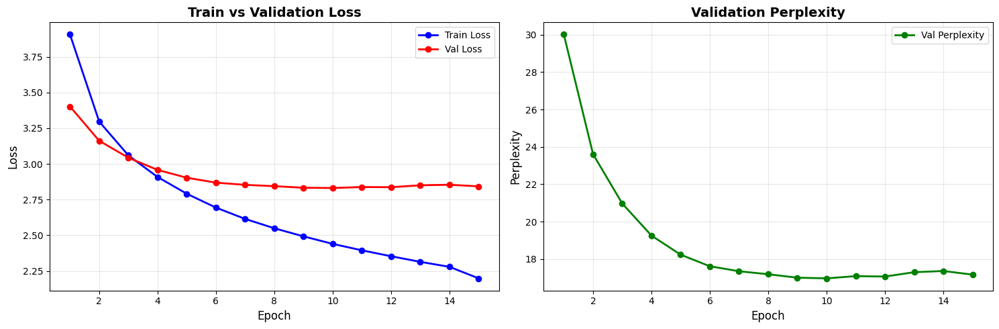

✅ Graphiques sauvegardés: outputs/training_curves.png

STATISTIQUES D'ENTRAÎNEMENT
Nombre d'epochs: 15

Train Loss:
  - Initial: 3.9052
  - Final: 2.1989
  - Meilleure: 2.1989 (epoch 15)

Val Loss:
  - Initial: 3.4016
  - Final: 2.8428
  - Meilleure: 2.8311 (epoch 10)

Val Perplexity:
  - Initial: 30.01
  - Final: 17.16
  - Meilleure: 16.96 (epoch 10)


In [80]:
# Plot des courbes de loss
plt.figure(figsize=(15, 5))

# Plot 1: Train vs Val Loss
plt.subplot(1, 2, 1)
epochs_range = range(1, len(history['train_loss']) + 1)
plt.plot(epochs_range, history['train_loss'], 'b-o', label='Train Loss', linewidth=2)
plt.plot(epochs_range, history['val_loss'], 'r-o', label='Val Loss', linewidth=2)
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Train vs Validation Loss', fontsize=14, fontweight='bold')
plt.legend(fontsize=10)
plt.grid(True, alpha=0.3)

# Plot 2: Validation Perplexity
plt.subplot(1, 2, 2)
plt.plot(epochs_range, history['val_perplexity'], 'g-o', label='Val Perplexity', linewidth=2)
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Perplexity', fontsize=12)
plt.title('Validation Perplexity', fontsize=14, fontweight='bold')
plt.legend(fontsize=10)
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig(OUTPUT_DIR / 'training_curves.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"✅ Graphiques sauvegardés: {OUTPUT_DIR / 'training_curves.png'}")

# Afficher les statistiques finales
print(f"\n{'='*60}")
print("STATISTIQUES D'ENTRAÎNEMENT")
print(f"{'='*60}")
print(f"Nombre d'epochs: {len(history['train_loss'])}")
print(f"\nTrain Loss:")
print(f"  - Initial: {history['train_loss'][0]:.4f}")
print(f"  - Final: {history['train_loss'][-1]:.4f}")
print(f"  - Meilleure: {min(history['train_loss']):.4f} (epoch {np.argmin(history['train_loss'])+1})")
print(f"\nVal Loss:")
print(f"  - Initial: {history['val_loss'][0]:.4f}")
print(f"  - Final: {history['val_loss'][-1]:.4f}")
print(f"  - Meilleure: {min(history['val_loss']):.4f} (epoch {np.argmin(history['val_loss'])+1})")
print(f"\nVal Perplexity:")
print(f"  - Initial: {history['val_perplexity'][0]:.2f}")
print(f"  - Final: {history['val_perplexity'][-1]:.2f}")
print(f"  - Meilleure: {min(history['val_perplexity']):.2f} (epoch {np.argmin(history['val_perplexity'])+1})")

In [84]:
# Sauvegarder la configuration complète
config = {
    'vocab_size': VOCAB_SIZE,
    'embed_dim': EMBED_DIM,
    'hidden_dim': HIDDEN_DIM,
    'num_layers': NUM_LAYERS,
    'dropout': DROPOUT,
    'batch_size': BATCH_SIZE,
    'learning_rate': LEARNING_RATE,
    'num_epochs': len(history['train_loss']),
    'best_val_loss': best_val_loss,
    'pad_idx': PAD_IDX,
    'start_idx': START_IDX,
    'end_idx': END_IDX,
    'max_caption_length': MAX_CAPTION_LENGTH
}

with open(CONFIG_SAVE_PATH, 'w') as f:
    json.dump(config, f, indent=4)

print(f"✅ Configuration sauvegardée: {CONFIG_SAVE_PATH}")

# Sauvegarder l'historique d'entraînement
history_path = OUTPUT_DIR / 'training_history.pkl'
with open(history_path, 'wb') as f:
    pickle.dump(history, f)

print(f"✅ Historique sauvegardé: {history_path}")

print(f"\n{'='*60}")
print("FICHIERS SAUVEGARDÉS")
print(f"{'='*60}")
print(f"  - Modèle: {MODEL_SAVE_PATH}")
print(f"  - Vocabulaire: {VOCAB_SAVE_PATH}")
print(f"  - Configuration: {CONFIG_SAVE_PATH}")
print(f"  - Historique: {history_path}")
print(f"  - Graphiques: {OUTPUT_DIR / 'training_curves.png'}")

✅ Configuration sauvegardée: outputs/config.json
✅ Historique sauvegardé: outputs/training_history.pkl

FICHIERS SAUVEGARDÉS
  - Modèle: outputs/best_model.pth
  - Vocabulaire: outputs/vocabulary.pkl
  - Configuration: outputs/config.json
  - Historique: outputs/training_history.pkl
  - Graphiques: outputs/training_curves.png


In [24]:
def load_model(model_path, vocab_path, config_path, device):
    """Charge le modèle sauvegardé"""
    
    # Charger la config
    with open(config_path, 'r') as f:
        config = json.load(f)
    
    # Charger le vocabulaire
    vocab = Vocabulary.load(vocab_path)
    
    # Créer le modèle
    model = CaptionModel(
        embed_dim=config['embed_dim'],
        hidden_dim=config['hidden_dim'],
        vocab_size=config['vocab_size'],
        num_layers=config['num_layers'],
        dropout=config['dropout']
    )
    
    # Charger les poids
    checkpoint = torch.load(model_path, map_location=device,weights_only=False)
    model.load_state_dict(checkpoint['model_state_dict'],strict=False)
    model = model.to(device)
    model.eval()
    
    print(f"✅ Modèle chargé depuis {model_path}")
    print(f"  - Epoch: {checkpoint['epoch']}")
    print(f"  - Val Loss: {checkpoint['val_loss']:.4f}")
    print(f"  - Val Perplexity: {checkpoint['val_perplexity']:.4f}")
    
    return model, vocab, config

# Test du chargement
loaded_model, loaded_vocab, loaded_config = load_model(
    MODEL_SAVE_PATH, 
    VOCAB_SAVE_PATH, 
    CONFIG_SAVE_PATH, 
    device
)

✅ Vocabulaire chargé: outputs/vocabulary.pkl
  - Taille: 2660
✅ Modèle chargé depuis outputs/best_model.pth
  - Epoch: 10
  - Val Loss: 2.8311
  - Val Perplexity: 16.9644


In [25]:
def generate_caption(model, image_tensor, vocab, device, max_length=50):
    """
    Génère une caption pour une image (greedy search)
    """
    model.eval()
    
    with torch.no_grad():
        # Préparer l'image
        image = image_tensor.unsqueeze(0).to(device)  # [1, 3, 224, 224]
        
        # Encoder l'image
        features = model.encoder(image)  # [1, embed_dim]
        
        # Initialiser avec <START>
        caption_indices = [vocab.word2idx[START_TOKEN]]
        
        # ✅ CORRECTION : Initialiser hidden state correctement
        batch_size = 1
        if hasattr(model, 'feature_to_hidden'):
            h = model.feature_to_hidden(features)  # [1, hidden_dim]
        else:
            h = features  # [1, embed_dim]
        
        h = h.unsqueeze(0).repeat(model.num_layers, 1, 1)  # [num_layers, 1, hidden_dim]
        c = torch.zeros_like(h)
        
        # Générer mot par mot
        for _ in range(max_length):
            # Embedding du dernier mot
            last_word = torch.LongTensor([caption_indices[-1]]).to(device)
            embed = model.embedding(last_word).unsqueeze(1)  # [1, 1, embed_dim]
            
            # LSTM step
            lstm_out, (h, c) = model.lstm(embed, (h, c))
            
            # Prédire le prochain mot
            output = model.fc(lstm_out.squeeze(1))  # [1, vocab_size]
            predicted_idx = output.argmax(1).item()
            
            # Ajouter à la caption
            caption_indices.append(predicted_idx)
            
            # Stop si <END>
            if predicted_idx == vocab.word2idx[END_TOKEN]:
                break
        
        # Décoder la caption
        caption = vocab.decode(caption_indices, skip_special=True)
        return caption



# Tester sur quelques images du validation set
print("="*60)
print("TEST DE GÉNÉRATION DE CAPTIONS")
print("="*60)

num_samples = 5
val_df = pd.read_csv(VAL_CAPTIONS, sep=SEPARATOR)

# Grouper par image pour avoir les 5 vraies captions
image_groups = val_df.groupby('image')['caption'].apply(list).reset_index()

for i in range(min(num_samples, len(image_groups))):
    image_name = image_groups.iloc[i]['image']
    true_captions = image_groups.iloc[i]['caption']
    
    # Charger le tenseur de l'image
    image_filename = image_name.split('.')[0] + '.pt'
    image_path = Path(VAL_DIR) / image_filename
    image_tensor = torch.load(image_path)
    
    # Générer la caption
    generated_caption = generate_caption(loaded_model, image_tensor, loaded_vocab, device)
    
    print(f"\n{'='*60}")
    print(f"Image {i+1}: {image_name}")
    print(f"{'='*60}")
    print(f"Caption générée:")
    print(f"  → {generated_caption}")
    print(f"\nVraies captions:")
    for j, cap in enumerate(true_captions, 1):
        print(f"  {j}. {cap}")

print(f"\n{'='*60}")
print("✅ Test de génération terminé!")
print(f"{'='*60}")

 

TEST DE GÉNÉRATION DE CAPTIONS

Image 1: 104136873_5b5d41be75.jpg
Caption générée:
  → a group of people are standing on a cliff overlooking the ocean

Vraies captions:
  1. People sit on the mountainside and check out the view .
  2. Three people are on a hilltop overlooking a green valley .
  3. Three people hang out on top of a big hill .
  4. Three people overlook a green valley .
  5. Three people rest on a ledge above the moutains .

Image 2: 106490881_5a2dd9b7bd.jpg
Caption générée:
  → a boy in a red shirt is jumping off a dock into a lake

Vraies captions:
  1. A boy in his blue swim shorts at the beach .
  2. A boy smiles for the camera at a beach .
  3. A young boy in swimming trunks is walking with his arms outstretched on the beach .
  4. Children playing on the beach .
  5. The boy is playing on the shore of an ocean .

Image 3: 1067180831_a59dc64344.jpg
Caption générée:
  → a black and white dog is running through a grassy field

Vraies captions:
  1. A black and white d

TEST DE GÉNÉRATION DE CAPTIONS - AVEC VÉRIFICATION


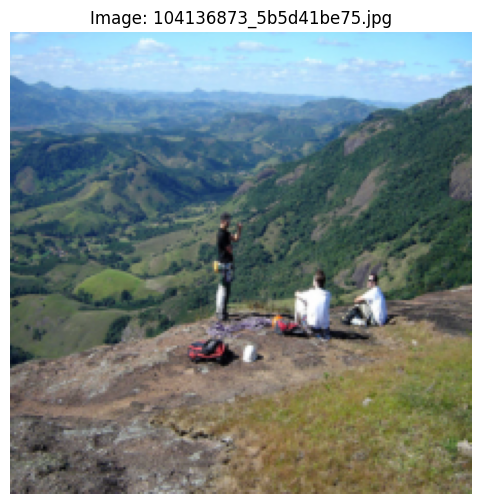


Image 1: 104136873_5b5d41be75.jpg
Caption générée:
  → a group of people are standing on a cliff overlooking the ocean

Vraies captions:
  1. People sit on the mountainside and check out the view .
  2. Three people are on a hilltop overlooking a green valley .
  3. Three people hang out on top of a big hill .
  4. Three people overlook a green valley .
  5. Three people rest on a ledge above the moutains .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


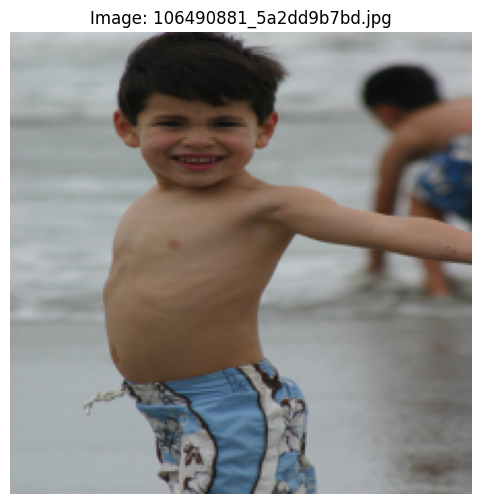


Image 2: 106490881_5a2dd9b7bd.jpg
Caption générée:
  → a boy in a red shirt is jumping off a dock into a lake

Vraies captions:
  1. A boy in his blue swim shorts at the beach .
  2. A boy smiles for the camera at a beach .
  3. A young boy in swimming trunks is walking with his arms outstretched on the beach .
  4. Children playing on the beach .
  5. The boy is playing on the shore of an ocean .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


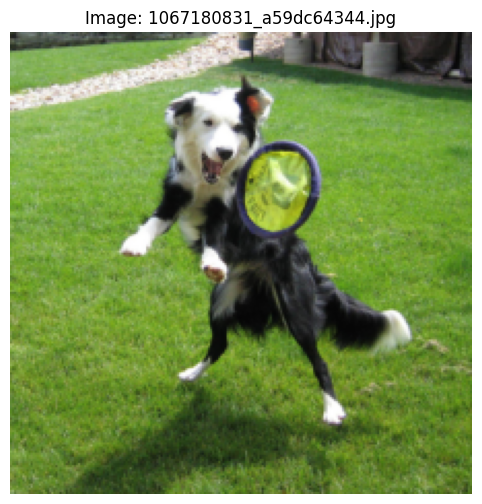


Image 3: 1067180831_a59dc64344.jpg
Caption générée:
  → a black and white dog is running through a grassy field

Vraies captions:
  1. A black and white dog is attempting to catch a yellow and purple object in a low cut yard .
  2. A black and white dog jumps after a yellow toy .
  3. a black and white dog jumps to get the Frisbee .
  4. A black dog is jumping up to catch a purple and green toy .
  5. A dog jumps to catch a toy .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


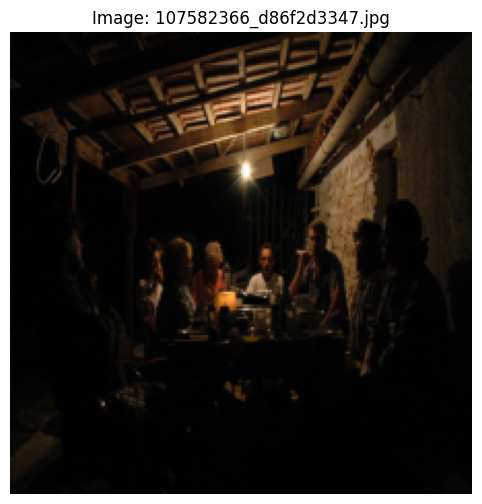


Image 4: 107582366_d86f2d3347.jpg
Caption générée:
  → a man in a black shirt and tie is standing in front of a crowd of people

Vraies captions:
  1. A group of eight people are gathered around a table at night .
  2. A group of people gathered around in the dark .
  3. A group of people sit around a table outside on a porch at night .
  4. A group of people sit outdoors together at night .
  5. A group of people sitting at a table in a darkened room .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


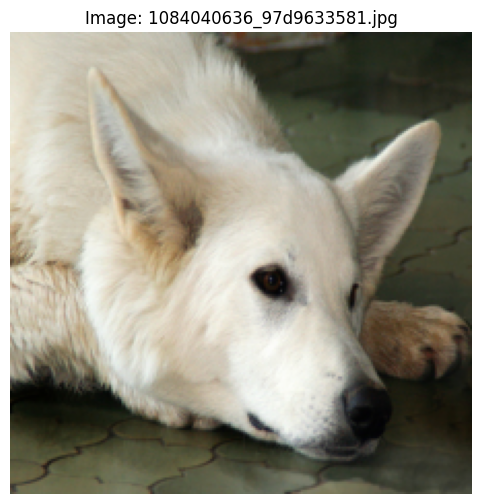


Image 5: 1084040636_97d9633581.jpg
Caption générée:
  → a dog is running through the water

Vraies captions:
  1. A closeup of a white dog that is laying its head on its paws .
  2. a large white dog lying on the floor .
  3. A white dog has its head on the ground .
  4. A white dog is resting its head on a tiled floor with its eyes open .
  5. A white dog rests its head on the patio bricks .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


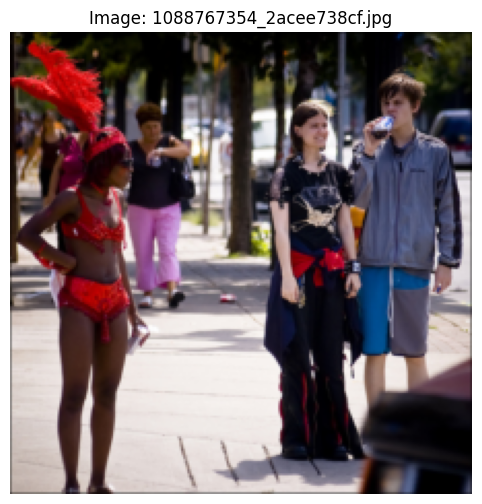


Image 6: 1088767354_2acee738cf.jpg
Caption générée:
  → a group of people are standing around a

Vraies captions:
  1. A woman in a red costume to the left of a man and woman standing together .
  2. A woman wearing a red costume looks at two other people standing on a street .
  3. A young woman in a red sequined costume and feather stands on the sidewalk .
  4. The girl in the salmon colored bikini is standing next to two young people ; one is wearing a black outfit and the other is drinking pop .
  5. Two young people are approached by a flamboyant young woman dressed in a red bikini and a red feathered headress .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


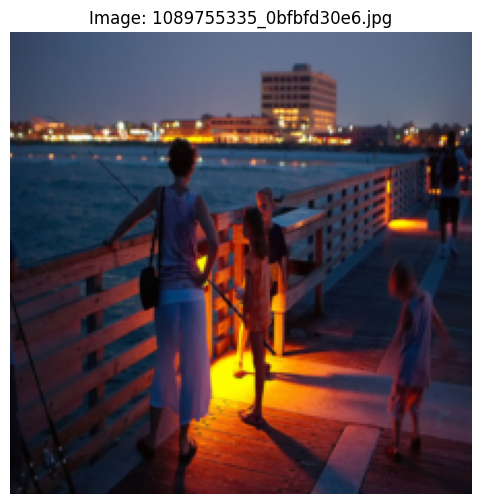


Image 7: 1089755335_0bfbfd30e6.jpg
Caption générée:
  → a group of people are sitting on a bench outside

Vraies captions:
  1. A mother and children is fishing on a boardwalk at night .
  2. A woman and three children stand on a deck with a fishing pole .
  3. A woman stands with children on a boardwalk at night overlooking the sea .
  4. Some people on a pier at night with one girl fishing off it .
  5. Woman with three children fishing over boardwalk in the evening .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


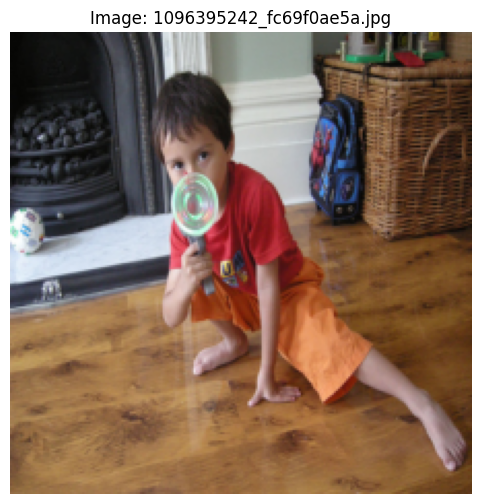


Image 8: 1096395242_fc69f0ae5a.jpg
Caption générée:
  → a little girl in a pink shirt is sitting on a wooden bench

Vraies captions:
  1. A boy with a toy gun .
  2. A little boy in orange shorts playing with a toy .
  3. A young boy with his foot outstretched aims a toy at the camera in front of a fireplace .
  4. A young child plays with his new light-up toy .
  5. Boy with toy gun pointed at the camera .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


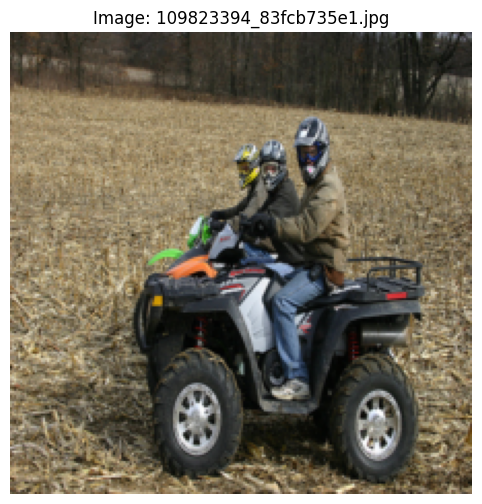


Image 9: 109823394_83fcb735e1.jpg
Caption générée:
  → a person in a red shirt is riding a bike down a dirt path

Vraies captions:
  1. Three people drive ATVs .
  2. Three people on ATVs in a brown field turn their heads to look at the camera .
  3. Three people on ATV 's outside .
  4. three people on four wheel ATV 's in a field .
  5. Three people ride their four wheelers through the field .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


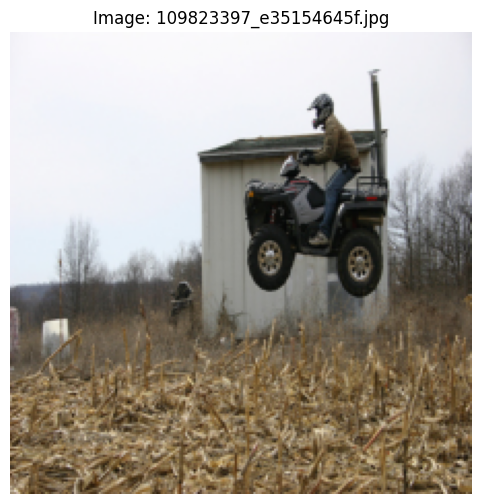


Image 10: 109823397_e35154645f.jpg
Caption générée:
  → a man in a red shirt is skateboarding

Vraies captions:
  1. A man jumps gin the air while riding an ATV
  2. A man on a four-wheeler jumps near a small building .
  3. An ATV is airborne over a field in front of a white structure .
  4. A person dressed in a tan jacket jumps a quad over a harvested cornfield in front of a small out building .
  5. Man on four wheeler in the air .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


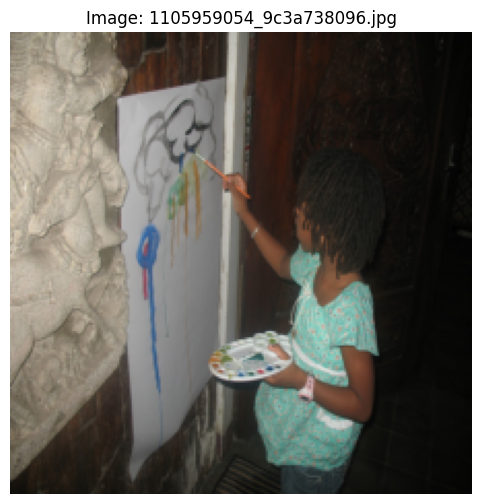


Image 11: 1105959054_9c3a738096.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick building

Vraies captions:
  1. A child painting a picture .
  2. An artist paints clouds onto a canvas .
  3. A young girl painting a picture .
  4. A young girl with braids is painting with water colors on a white paper on the wall .
  5. The child paints on a large paper with water colors .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


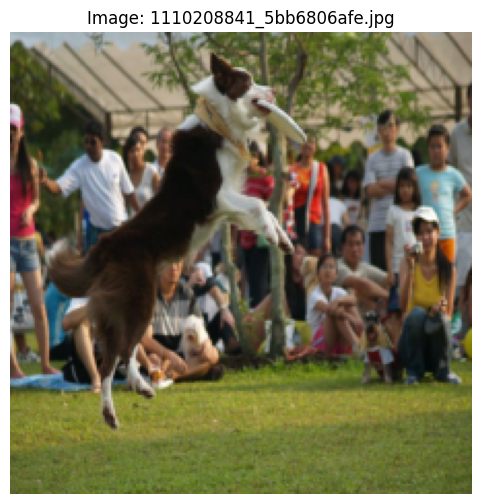


Image 12: 1110208841_5bb6806afe.jpg
Caption générée:
  → a man in a black shirt and white shorts is running in the grass

Vraies captions:
  1. A black and white Border Collie catches a Frisbee in front of an audience .
  2. a brown and white dog catches a Frisbee in it mouth in front of a group of people .
  3. A brown and white dug jumping up to catch a Frisbee while an audience watches .
  4. A dog jumps to catch a Frisbee , while many people watch .
  5. An agile dog catches a Frisbee while a crowd of onlookers watches closely .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


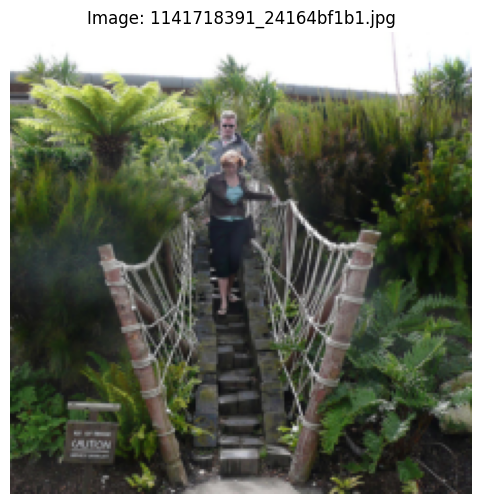


Image 13: 1141718391_24164bf1b1.jpg
Caption générée:
  → a man in a black shirt is standing on a sidewalk with his arms crossed

Vraies captions:
  1. A bridge through high green plants , a man and a woman on it .
  2. A man and a woman are crossing over a rope bridge with greenery all over them .
  3. A man and a woman are walking across a rope bridge .
  4. A man and a woman crossing a suspension bridge in a tropical setting .
  5. Woman and man walking across wooden rope bridge with a caution sign beside it .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


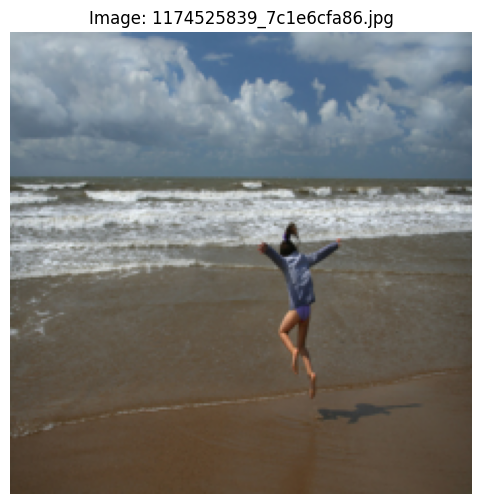


Image 14: 1174525839_7c1e6cfa86.jpg
Caption générée:
  → a man in a wetsuit is surfing

Vraies captions:
  1. A girl in blue is jumping on the shore as small waves approach her .
  2. A girl leaps into the air while standing by the ocean .
  3. A young , long-haired , girl on the beach , is jumping in the air .
  4. The girl is running into the ocean from the shore .
  5. The girls is jumping into the air on the beach .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


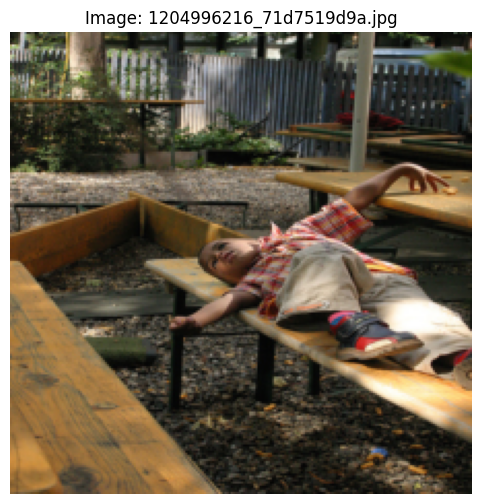


Image 15: 1204996216_71d7519d9a.jpg
Caption générée:
  → a man in a red shirt is standing on a sidewalk with a

Vraies captions:
  1. A boy lays on a picnic table bench .
  2. A child is laying down on a wooden bench .
  3. A child is on a bench with arms stretched out .
  4. A little boy in a red shirt sitting on a wooden picnic table bench .
  5. A little boy lies down on a picnic table bench .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


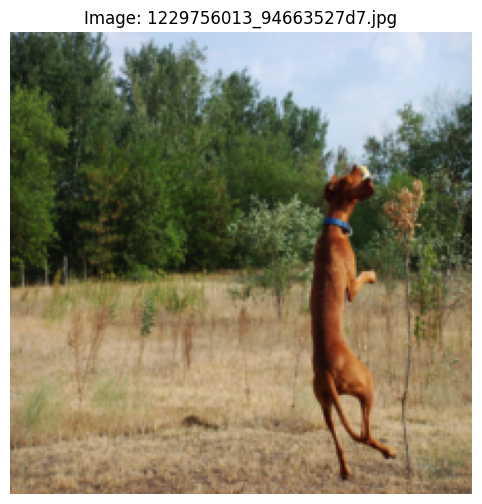


Image 16: 1229756013_94663527d7.jpg
Caption générée:
  → a brown dog is running across the grass

Vraies captions:
  1. A brown dog jumping in the air on a brown plain .
  2. A brown dog jumping into the air to catch a ball .
  3. A brown dog leaping to catch a ball .
  4. A coppery dog leaps to catch a ball .
  5. A dog leaps into the air in a grassy field surrounded by trees .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


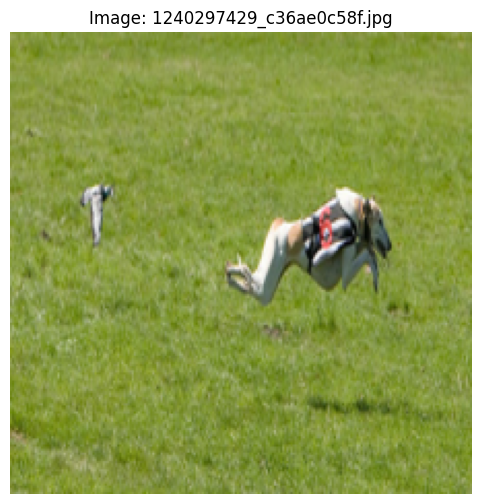


Image 17: 1240297429_c36ae0c58f.jpg
Caption générée:
  → a dog jumps over a bar

Vraies captions:
  1. A dog in a number six jersey is running through a field .
  2. A dog is leaping through the grass .
  3. A dog is wearing a red number 6 and running through a field of green grass while being chased by a bird .
  4. A white and tan dog leaps through the air .
  5. The dog in a vest leaps in the air and there is a bird flying .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


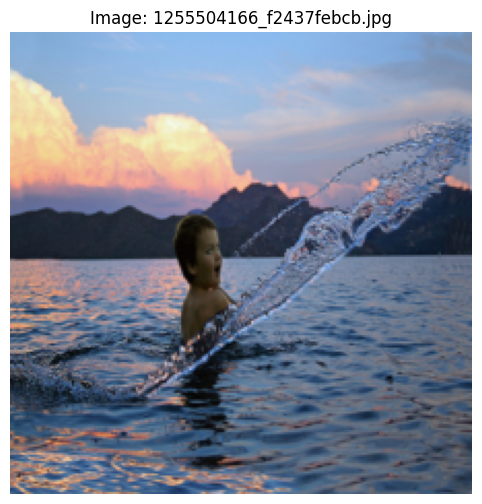


Image 18: 1255504166_f2437febcb.jpg
Caption générée:
  → a man in a red shirt is standing in the ocean with a surfboard in the background

Vraies captions:
  1. A boy playing in a lake
  2. A child is splashing in the water
  3. A little boy is playing in the water with a beautiful sunset and mountains in the background .
  4. A small child in water with a splash encircling him while the white clouds float over the mountains .
  5. A young boy plays in the water with the mountains in the background .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


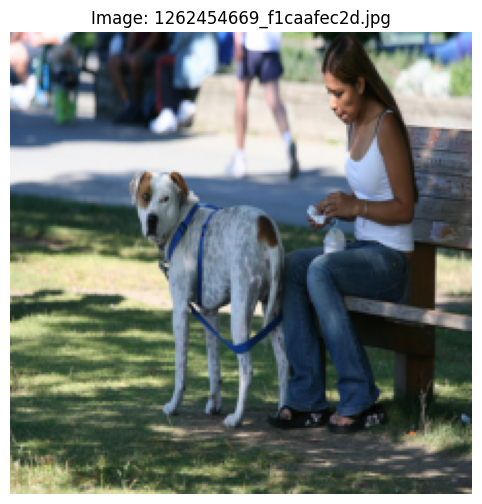


Image 19: 1262454669_f1caafec2d.jpg
Caption générée:
  → a dog jumps over a bar

Vraies captions:
  1. A girl in a white shirt is sitting on a park bench with a dog next to her .
  2. A woman eats on a bench while a brown and white leashed dog stands next to her .
  3. a woman is sitting on a bench with a latte in her lap and a white dog on a blue leash to her side .
  4. A woman sits on a bench at the park with her dog in front of her .
  5. Woman sitting on bench and holding the leash of a large white and brown dog .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


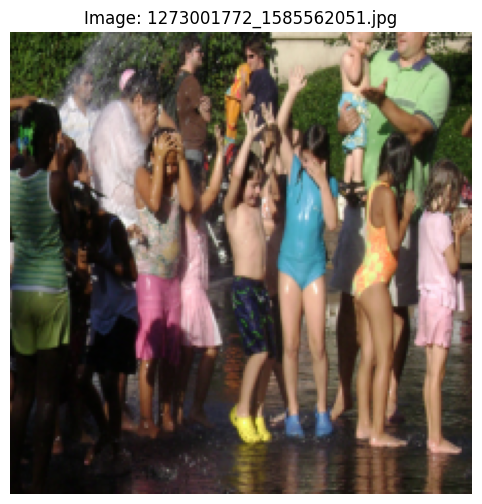


Image 20: 1273001772_1585562051.jpg
Caption générée:
  → a group of people are standing in front of a large red brick building

Vraies captions:
  1. About 12 kids and a few adults get splashed by an off camera source .
  2. A group of children are in a water fountain .
  3. A group of children standing in a shallow pool of water .
  4. A group of young kids play in the water on a sunny day .
  5. Children and adults play with a sprinkler .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


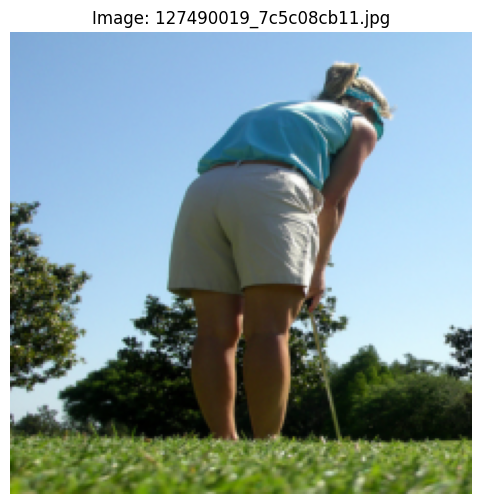


Image 21: 127490019_7c5c08cb11.jpg
Caption générée:
  → a boy in a red shirt is standing on a rock overlooking a valley

Vraies captions:
  1. A girl is getting ready to swing the club .
  2. A woman in shorts and a blue sleeveless shirt leans over a golf club .
  3. A woman is taking a swing with a golf club .
  4. A woman wearing a blue shirt and hat with khaki shorts plays golf .
  5. A woman wearing blue begins a golf swing .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


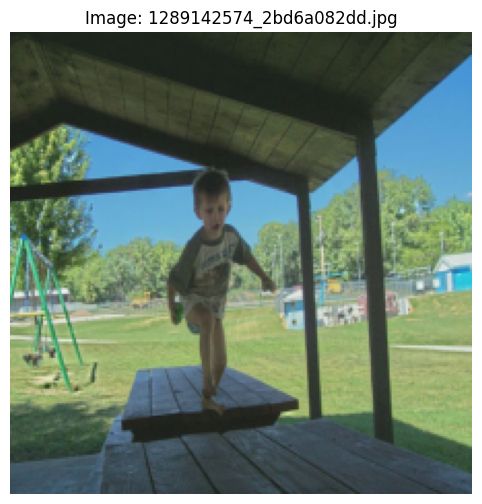


Image 22: 1289142574_2bd6a082dd.jpg
Caption générée:
  → a man in a red shirt is standing on a sidewalk with a

Vraies captions:
  1. A boy jumps from one picnic table to another .
  2. A boy jumps from one table to another at a park .
  3. A child is walking from one picnic table to another .
  4. A young boy is running on picnic tables at a park .
  5. The boy hops from one picnic table to the other in the park .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


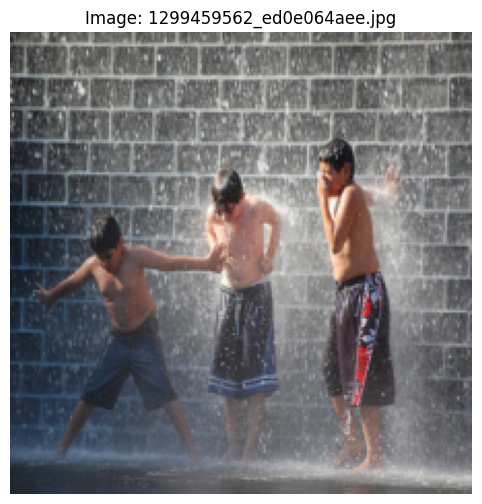


Image 23: 1299459562_ed0e064aee.jpg
Caption générée:
  → a man and a woman are standing on a sidewalk in front of a large crowd

Vraies captions:
  1. Three boys in baggy bathing suits play in splashing water in front a of grey , block wall .
  2. three boys in size order getting wet next to a wall
  3. Three boys play in a spray of water .
  4. Three boys playing in some water .
  5. Three shirtless boys are playing in the water .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


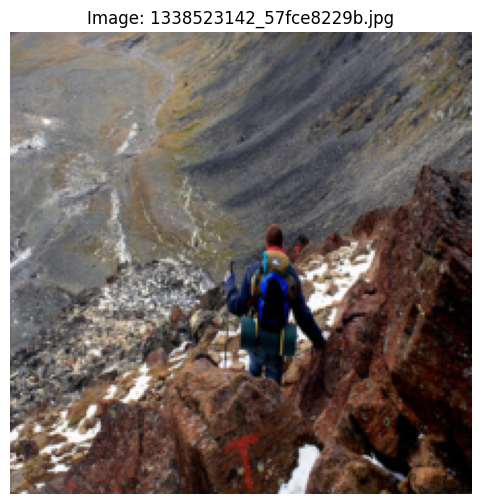


Image 24: 1338523142_57fce8229b.jpg
Caption générée:
  → a man in a red shirt climbs a rock wall

Vraies captions:
  1. A backpacker walks down a rocky mountain .
  2. A hiker walks down a rocky path towards land with water .
  3. A man with a black and blue backpack hikes down a rock face .
  4. Hiker climbing down a snow and rock covered mountain .
  5. The man climbs through the rocks and snow .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


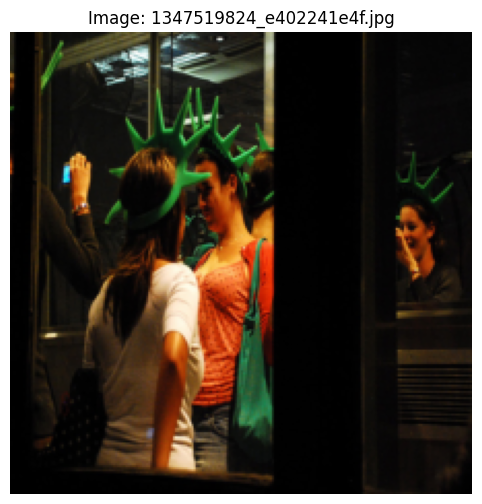


Image 25: 1347519824_e402241e4f.jpg
Caption générée:
  → a group of people are standing together

Vraies captions:
  1. A few girls with green foam statue of liberty hats on a train
  2. Some young adults are wearing green foam statute of liberty crowns .
  3. Some young people take photos of each other while in New York .
  4. Three woman with statue of liberty hats and taking a picture .
  5. Two woman wearing statue of liberty hats get their picture taken in a subway .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


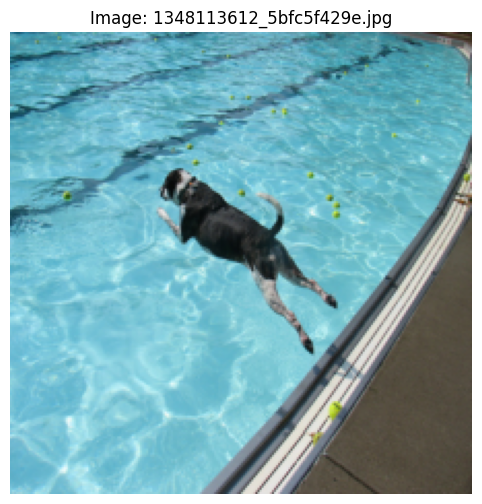


Image 26: 1348113612_5bfc5f429e.jpg
Caption générée:
  → a dog swims in the water

Vraies captions:
  1. A black and white dog jumping into a pool after tennis balls .
  2. a black and white dog jumping into a pool with a lot of tennis balls in it .
  3. A black dog jumps into a pool that has many yellow balls in it .
  4. A dog jumps into a swimming pool to retrieve some floating tennis balls .
  5. A dog swims in a pool .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


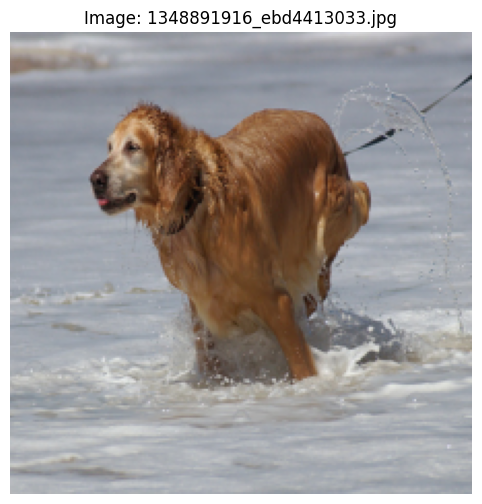


Image 27: 1348891916_ebd4413033.jpg
Caption générée:
  → a dog swims in the water

Vraies captions:
  1. A brown dog on a leash runs through the white water .
  2. A soaked dog is playing in the water .
  3. A tan dog on a leash running in shallow ocean water .
  4. A wet dog on a leash is running through some water .
  5. Brown dog running through shallow water .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


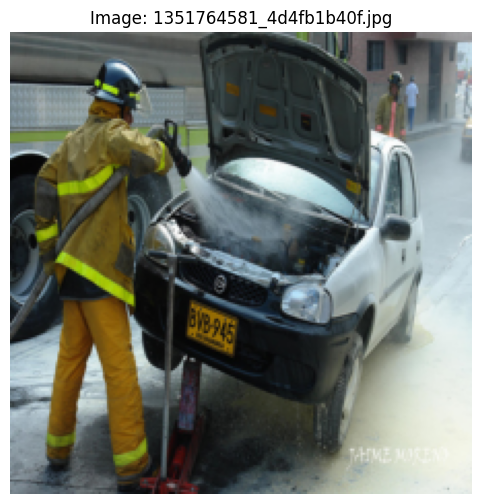


Image 28: 1351764581_4d4fb1b40f.jpg
Caption générée:
  → a man in a red shirt is skateboarding

Vraies captions:
  1. A firefighter extinguishes a fire under the hood of a car .
  2. a fireman spraying water into the hood of small white car on a jack
  3. A fireman sprays inside the open hood of small white car , on a jack .
  4. A fireman using a firehose on a car engine that is up on a carjack .
  5. Firefighter uses water to extinguish a car that was on fire .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


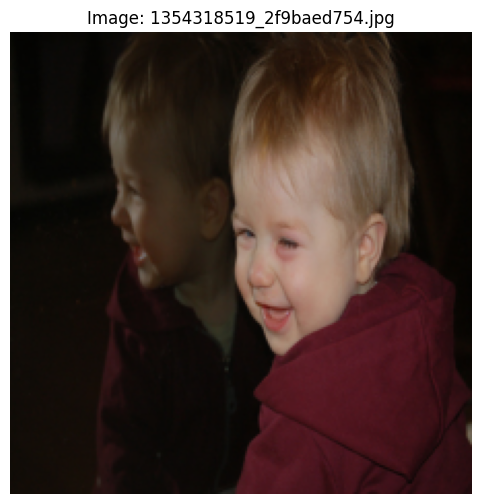


Image 29: 1354318519_2f9baed754.jpg
Caption générée:
  → a little girl in a pink shirt is sitting on a wooden bench

Vraies captions:
  1. A baby is laughing .
  2. A baby laughs at his reflection in a mirror .
  3. A blonde haired toddler in a burgundy hoodie smiling .
  4. a boy in a red hooded top is smiling whilst looking away from his reflection .
  5. A child in front of his own reflection turning towards the camera and smiling .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


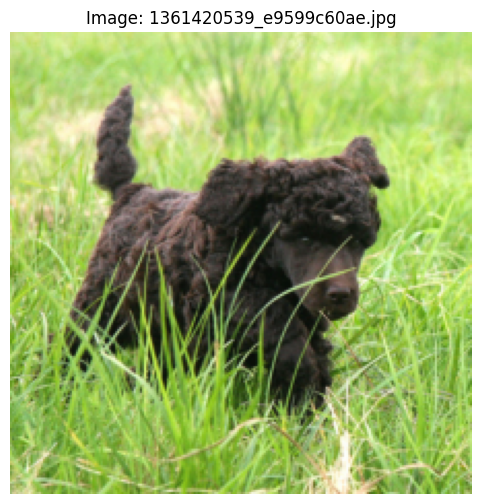


Image 30: 1361420539_e9599c60ae.jpg
Caption générée:
  → a black dog is running through the grass

Vraies captions:
  1. A black dog is running in the grass .
  2. A black poodle is running through the grass .
  3. A small black dog is in the grass .
  4. The black dog is running through the grass .
  5. The black dog is walking through the tall grass .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


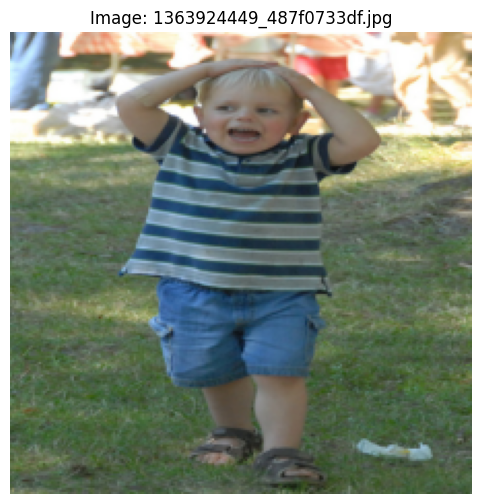


Image 31: 1363924449_487f0733df.jpg
Caption générée:
  → a little girl in a pink shirt is sitting on a wooden bench

Vraies captions:
  1. A boy holds his hands on his head .
  2. A child with his hands on his head .
  3. A little boy in a striped shirt has his hands on his head .
  4. A little boy stands with his hands on top of his head
  5. The blond boy wearing a striped shirt is walking through the grass .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


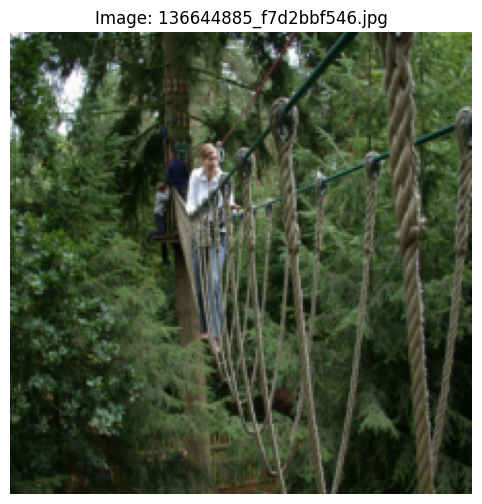


Image 32: 136644885_f7d2bbf546.jpg
Caption générée:
  → a man and a woman sit on a bench

Vraies captions:
  1. A group of people walking across a rope bridge .
  2. A woman is crossing a rope bridge .
  3. A woman is crossing a rope bridge in the trees with other people waiting at one end .
  4. A woman wearing a white shirt and jeans crosses a rope bridge in a wooded area .
  5. three people are crossing a rope bridge hung between pine trees .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


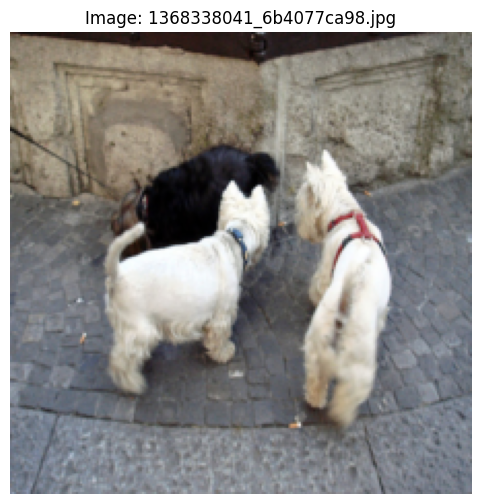


Image 33: 1368338041_6b4077ca98.jpg
Caption générée:
  → a black dog is running through the grass

Vraies captions:
  1. Three dogs looking at a cement ledge .
  2. Three dogs on a sidewalk .
  3. Three small dogs sniff at somthing .
  4. Three small dogs , two white and one black and white , on a sidewalk .
  5. Two white dogs look at one black dog on a paved walkway .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


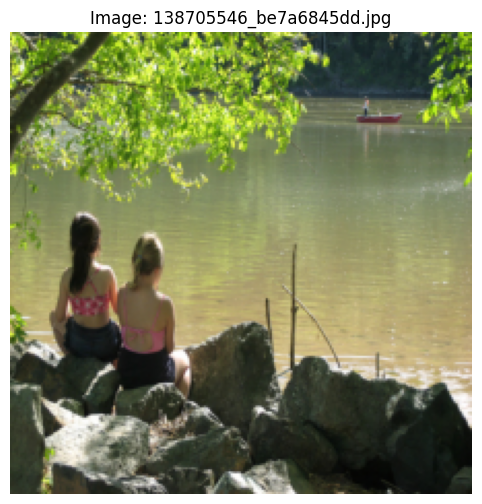


Image 34: 138705546_be7a6845dd.jpg
Caption générée:
  → a man and a woman are sitting on a bench by the ocean

Vraies captions:
  1. Two girls looking out over a lake towards a man fishing .
  2. Two girls on the shore watch people in a boat fish .
  3. Two girls sit along a lake while a man in the background fishes
  4. Two little girls in bathing suits sit on the shore of a lake , watching someone fishing from a boat .
  5. Two little girls in pink bathing suit tops sit on rocks by the water .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


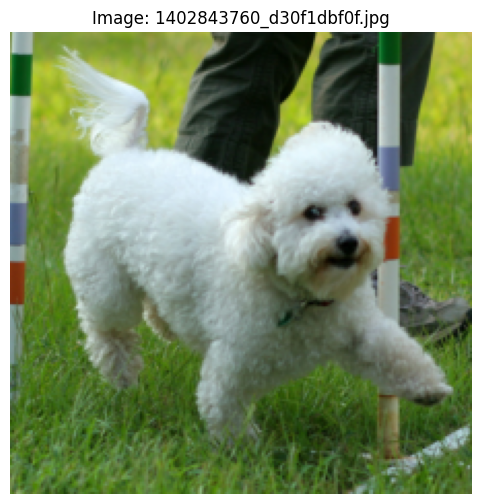


Image 35: 1402843760_d30f1dbf0f.jpg
Caption générée:
  → a dog with a red collar is running in the grass

Vraies captions:
  1. a dog trots through the grass .
  2. A fluffy white dog is outside .
  3. A white dog competing in an agility event .
  4. A white dog lifts its paw as it stands on the grass near striped poles .
  5. The small furry white dog is walking in the green grass .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


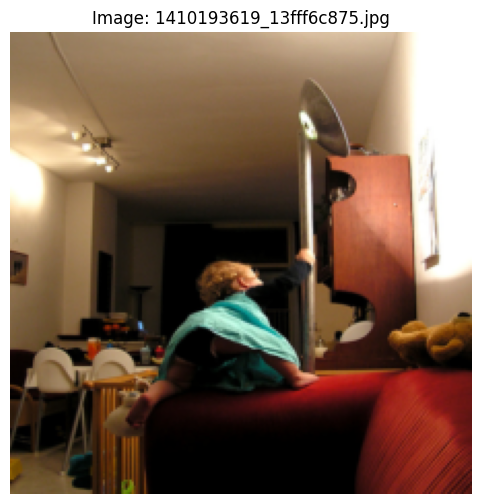


Image 36: 1410193619_13fff6c875.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick building

Vraies captions:
  1. A baby stands on the side of a couch and knocks over a lamp .
  2. A small child climbs onto the arm of a red couch .
  3. Baby indoors , climbing on red couch arm , reaching for lamp .
  4. Small girl in a teal dress on the arm of a chair reaching for a floor lamp .
  5. Woman sitting on a red couch inside the house .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


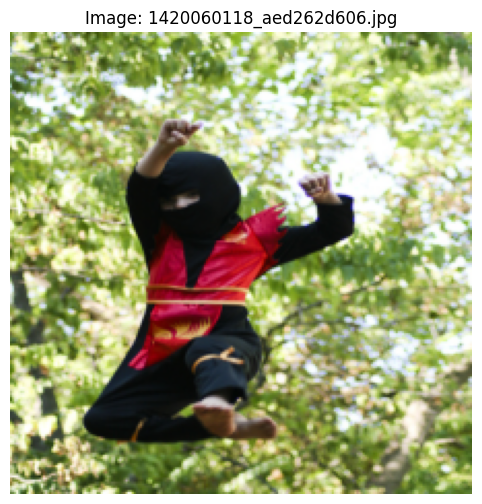


Image 37: 1420060118_aed262d606.jpg
Caption générée:
  → a boy in a red shirt is jumping off a wooden platform

Vraies captions:
  1. A child dressed as a ninja is jumping through the air under a large tree .
  2. A child in a ninja outfit does a jumping kick .
  3. A man wearing a martial arts uniform is jumping through the air .
  4. A person with a black and red outfit and a black hood is up in the air .
  5. a young ninja jumps into the air .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


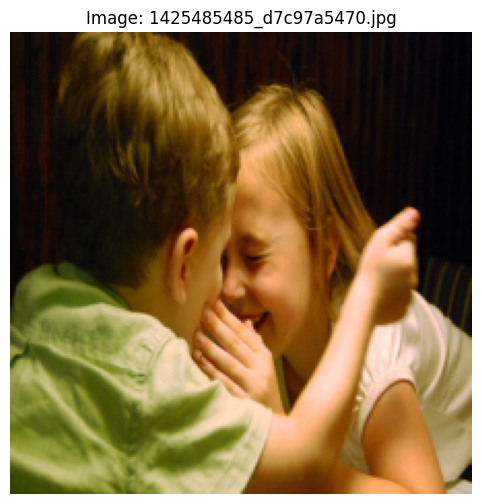


Image 38: 1425485485_d7c97a5470.jpg
Caption générée:
  → a little girl in a pink shirt is sitting on a wooden bench

Vraies captions:
  1. A girl touches a boys face ; both are smiling .
  2. A girl with her eyes closed is touching a boy 's cheeks .
  3. Little girl laughing and touching a boy 's face as they lean toward each other .
  4. Two children , a boy and a girl .
  5. Two children facing each other and laughing .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


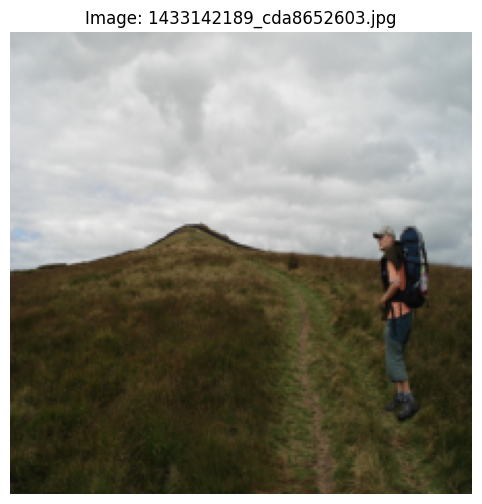


Image 39: 1433142189_cda8652603.jpg
Caption générée:
  → a man in a red shirt climbs a rock wall

Vraies captions:
  1. A hiker is walking a treeless path up a hill .
  2. A man is backpacking up a grassy hill .
  3. A man with a big backpack is walking through a grass trail up a hill .
  4. Person hiking up a grassy trail toward a large hill .
  5. The hiker is following a trail uphill .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


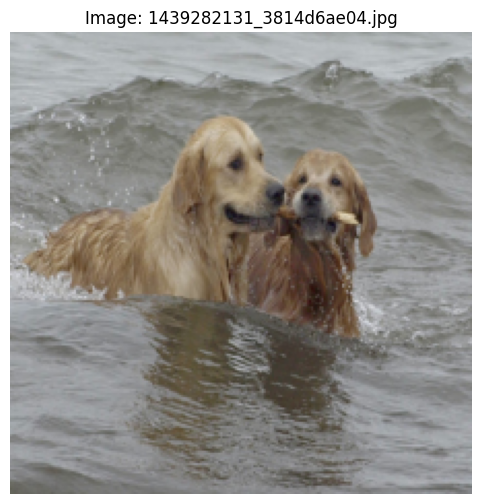


Image 40: 1439282131_3814d6ae04.jpg
Caption générée:
  → a dog swims in the water

Vraies captions:
  1. The two dogs are in the water retrieving a stick .
  2. Two dogs are holding the same stick in their mouths while in the water .
  3. Two dogs in the surf holding on to the same stick .
  4. Two dogs in the water fighting over a stick .
  5. Two dogs swimming with a stick .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


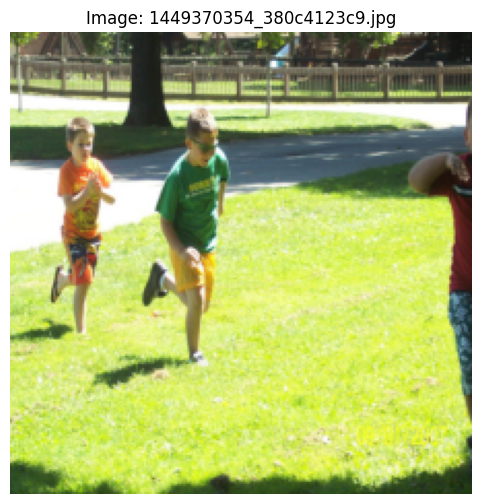


Image 41: 1449370354_380c4123c9.jpg
Caption générée:
  → a little girl in a pink shirt is running on the grass

Vraies captions:
  1. Kids running across the grass .
  2. Three young boys are running on grass .
  3. Two boys , one wearing glasses , run across grass . Third child partially in shot .
  4. two young boys running on a grassy field
  5. Young boys running on grass .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


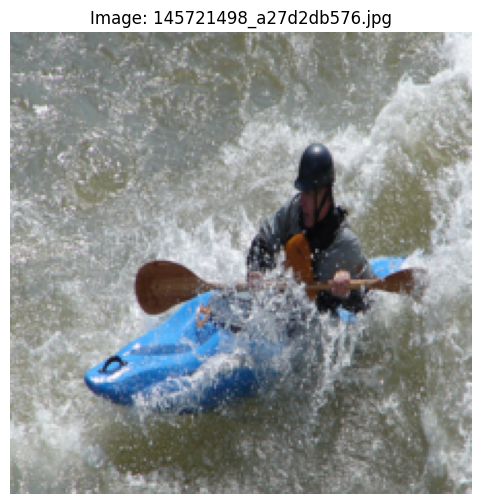


Image 42: 145721498_a27d2db576.jpg
Caption générée:
  → a man in a wetsuit is surfing

Vraies captions:
  1. A man in a blue canoe battling through rough waves
  2. A man kayaks through rough water .
  3. A man rows a blue kayak through white water rapids .
  4. Man paddling in blue kayak in the water .
  5. The kayaker braces himself as he goes down the river .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


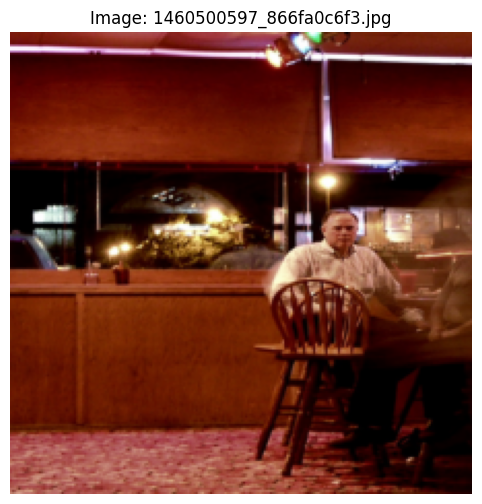


Image 43: 1460500597_866fa0c6f3.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick building

Vraies captions:
  1. A man is sitting in room made up of wood panelling .
  2. A man sits at a table in a room .
  3. Man sitting at a table in a restaurant .
  4. The man in the button up shirt is sitting at a table .
  5. There is a man sitting in a restaurant at night .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


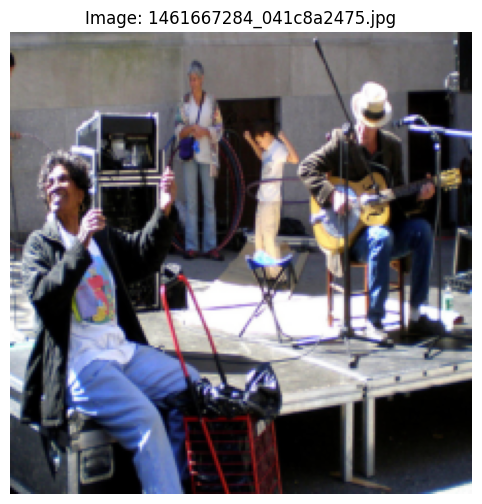


Image 44: 1461667284_041c8a2475.jpg
Caption générée:
  → a man in a black shirt and tie is standing in front of a crowd of people

Vraies captions:
  1. A guitarist plays while people play with hula-hoops in the background .
  2. A guitarist sits playing before microphones , while a man and a boy dance and a woman stands by .
  3. A man in a white hat plays guitar on a stage .
  4. A man plays guitar on a stage while another woman smiles
  5. Four people performing music outdoors .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


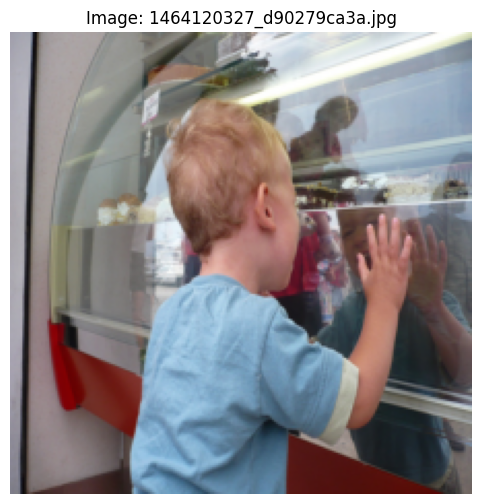


Image 45: 1464120327_d90279ca3a.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick wall

Vraies captions:
  1. A little boy presses his face a window .
  2. A little boy puts his face up to the uniquely-shaped window .
  3. A little boy stands up next to a window and cries .
  4. A young boy in a blue shirt presses against the glass for a better look at desserts .
  5. Little boy peering into a glass display case .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


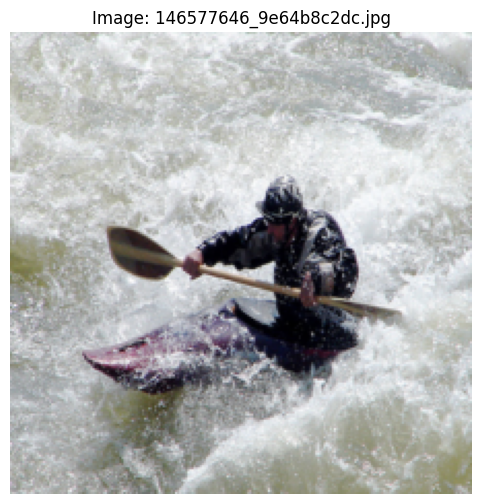


Image 46: 146577646_9e64b8c2dc.jpg
Caption générée:
  → a man in a wetsuit is surfing

Vraies captions:
  1. A kayaker is battling waves in a purple boat while wearing rain gear .
  2. A man is paddling in whitewater rapids .
  3. A man kayaks in rough water .
  4. Man in a kayak swimming in rough waters .
  5. Person kayaking in white water .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


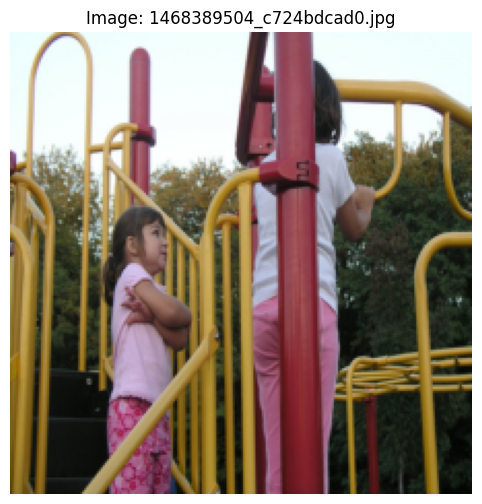


Image 47: 1468389504_c724bdcad0.jpg
Caption générée:
  → a little girl in a pink shirt is running on a sidewalk

Vraies captions:
  1. Two girls in pink are playing on yellow playground bars .
  2. Two girls on a jungle gym .
  3. Two little girls in pink outfits play on a yellow and red playground .
  4. Two young girls on a playground .
  5. two young girls wearing pink outfits playing on yellow monkey bars .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


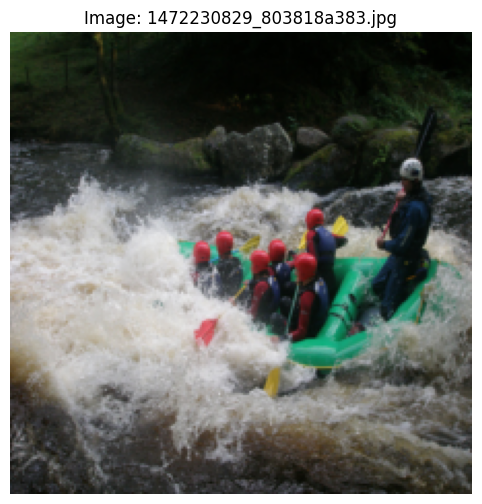


Image 48: 1472230829_803818a383.jpg
Caption générée:
  → a man in a red shirt is standing in front of a large wave

Vraies captions:
  1. A group of people in a boat , white water rafting .
  2. A group of seven people are rafting in the rapids in a green boat .
  3. Rafting boat on river .
  4. seven people are riding a green raft in a white water river .
  5. Seven rafters are paddling and riding the rapids in a green raft .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


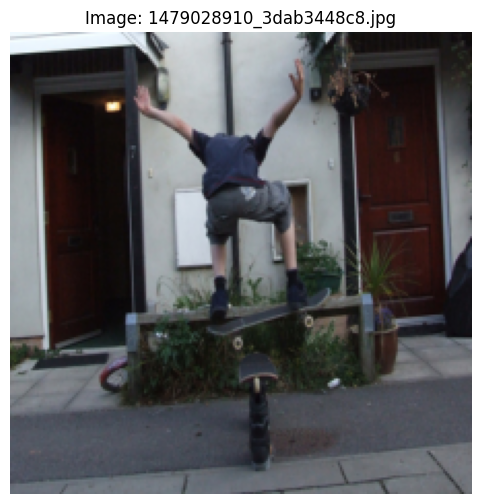


Image 49: 1479028910_3dab3448c8.jpg
Caption générée:
  → a man in a black shirt is skateboarding

Vraies captions:
  1. A boy skateboards and does a jump over another skateboard .
  2. A skateboarder attempts to do a trick over a homemade ramp .
  3. A skateboarder in gray clothes jumps over a boot in front of an apartment .
  4. A skateboarder is jumping over an obstacle in front of a white house .
  5. A skateboarder jumps another skateboard .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


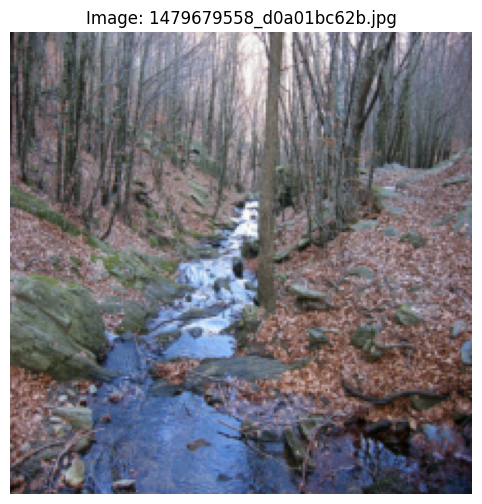


Image 50: 1479679558_d0a01bc62b.jpg
Caption générée:
  → a man in a red shirt climbs a rock wall

Vraies captions:
  1. A creek winds through the woods .
  2. A narrow stream runs between leaf-covered hills .
  3. A river is winding through a wooded area that is heavily leaf covered .
  4. A small brook meanders through the autumn woods .
  5. This is a small creek surrounded by autumn leaves that have fallen and bare trees .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


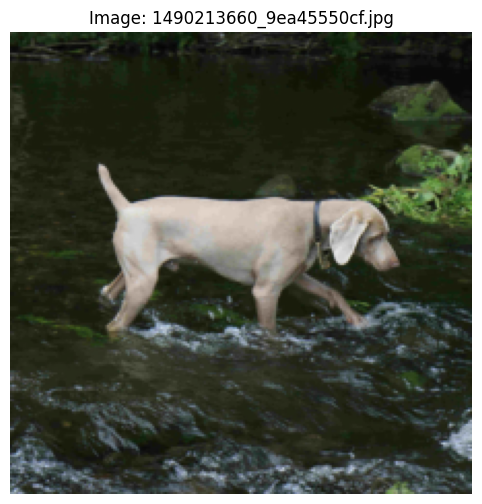


Image 51: 1490213660_9ea45550cf.jpg
Caption générée:
  → a dog swims in the water

Vraies captions:
  1. A dog is trotting through a shallow stream
  2. A light colored dog is walking through a stream .
  3. A male weimaraner with a clipped tail is walking through a river .
  4. a tan dog walking along in a stream
  5. The brown dog is walking through a river surrounded by bushes .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


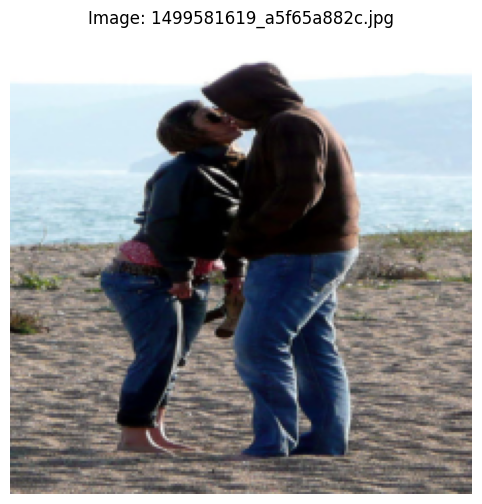


Image 52: 1499581619_a5f65a882c.jpg
Caption générée:
  → a man in a red shirt is standing in front of a large rock formation

Vraies captions:
  1. A couple dressed in hoodies kissing on the beach .
  2. A man and a woman share a kiss on the beach .
  3. A man with a brown hooded jacket is kissing a girl with sunglasses .
  4. There is a couple kissing on the beach .
  5. Two people kiss on the beach .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


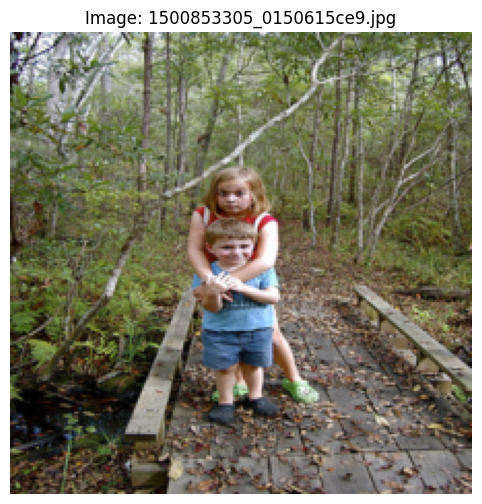


Image 53: 1500853305_0150615ce9.jpg
Caption générée:
  → a little girl in a pink shirt is walking on a path

Vraies captions:
  1. A girl and a boy hugging on a bridge
  2. A little girl has her arms around a little boy standing on a wooden bridge in the woods .
  3. A little girl hugs her brother on a footbridge in a forest .
  4. Two children hugging on a bridge .
  5. Two little children are on a wooden bridge in the woods .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


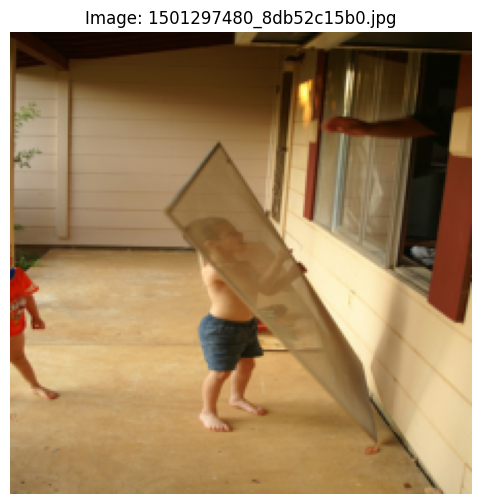


Image 54: 1501297480_8db52c15b0.jpg
Caption générée:
  → a little girl in a pink shirt is walking on a sidewalk

Vraies captions:
  1. A boy tries to put a screen on a window .
  2. A child wearing shorts is moving a window screen .
  3. A shirtless child in blue shorts holding up a window screen that has fallen out .
  4. little boy in blue shorts holding a window screen
  5. Young boy wearing denim shorts holding a window screen .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


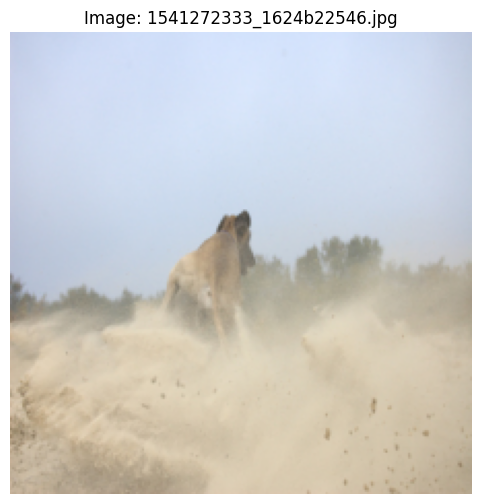


Image 55: 1541272333_1624b22546.jpg
Caption générée:
  → a dog is running through the snow

Vraies captions:
  1. A brown dog brings up some dust as he runs around a field .
  2. A dog and a dust storm .
  3. A dog and sand blowing in the wind
  4. A dog in a sandy area with the sand stirred up into the air and several plants in the background .
  5. Dog kicking up dirt

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


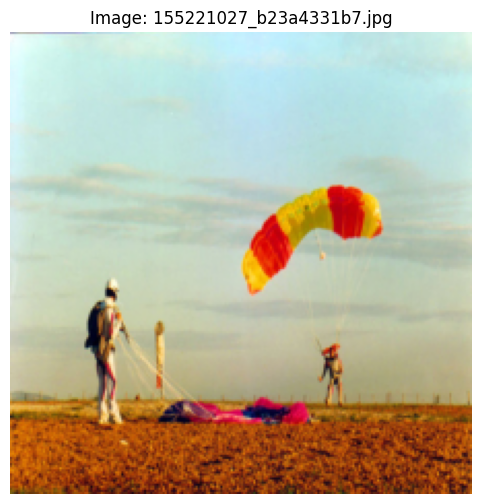


Image 56: 155221027_b23a4331b7.jpg
Caption générée:
  → a young boy in a red shirt is running towards the camera

Vraies captions:
  1. A skydiver safely lands while another watches from the ground .
  2. Two men with colorful parachutes have just landed in a field .
  3. Two para gliders are practicing their craft in an open field .
  4. Two people are landing from their sky diving exercises .
  5. Two people parachutes into a field .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


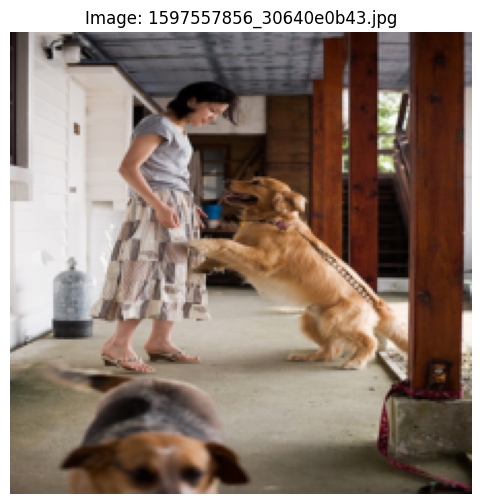


Image 57: 1597557856_30640e0b43.jpg
Caption générée:
  → a brown dog is running across the grass

Vraies captions:
  1. a brown dog is jumping up at a woman who is wearing a brown skirt .
  2. A golden retriever is excitedly greeting a woman as a little dog walks towards the camera .
  3. A tan dog jumping up at a woman in a skirt and a black and tan dog walking away .
  4. A yellow dog jumps to greet a woman .
  5. One dog is jumping at the lady while the other walks away .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


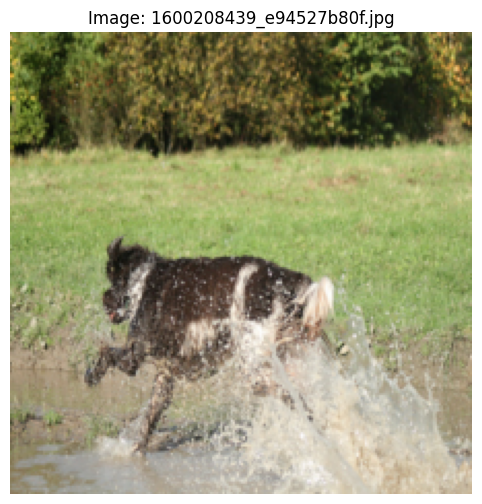


Image 58: 1600208439_e94527b80f.jpg
Caption générée:
  → a dog is running through the snow

Vraies captions:
  1. A brown dog playing in mud .
  2. A dog enjoys playing in the water at the edge of a field .
  3. A dog is playing in water .
  4. A dog runs through muddy water .
  5. A dog splashing though a large puddle in a field .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


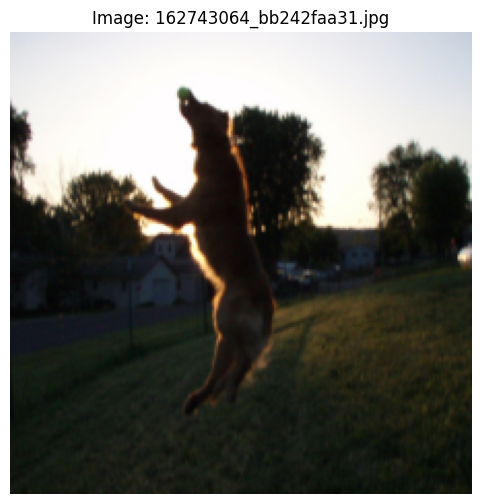


Image 59: 162743064_bb242faa31.jpg
Caption générée:
  → a black dog is running through the grass

Vraies captions:
  1. A brown dog catching a ball in silhouette .
  2. a brown dog is leaping into the air to catch a ball .
  3. A dog catching a tennis ball at sunset in a yard .
  4. A dog is backlit buy the sun as he jumps up to catch a tennis ball .
  5. A dog jumps in the air to catch a tennis ball .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


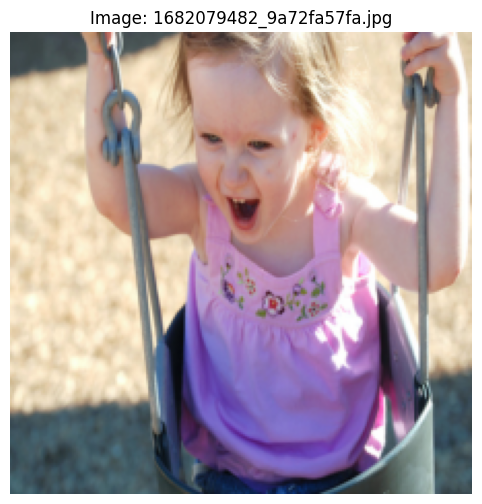


Image 60: 1682079482_9a72fa57fa.jpg
Caption générée:
  → a little girl in a pink shirt is playing with a toy

Vraies captions:
  1. A little girl on a kid swing .
  2. A little girl shouts for joy as she swings on the swing .
  3. A toddler girl in a swing is laughing .
  4. A toddler in a pink shirt in a bucket swing .
  5. A young girl making a wide mouthed expression while swinging .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


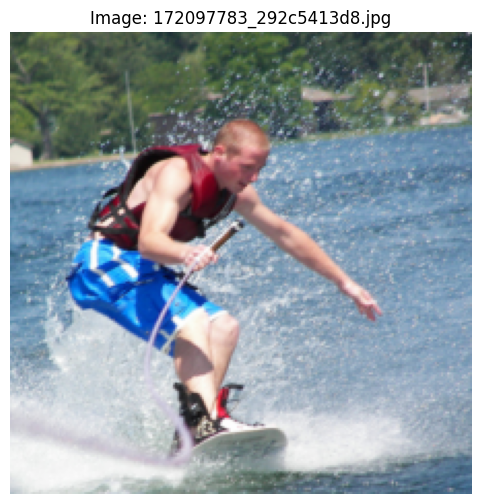


Image 61: 172097783_292c5413d8.jpg
Caption générée:
  → a man in a wetsuit is surfing

Vraies captions:
  1. A boy is wakeboarding on a lake with one hand .
  2. A man wearing a red life jacket is water-skiing across a bay .
  3. A surfer in blue shorts surfs over water .
  4. A young man dressed in blue swimming trunks and a red life jacket waterskiing in a blue lake .
  5. Boy in red vest and blue and white trunks on wakeboard .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


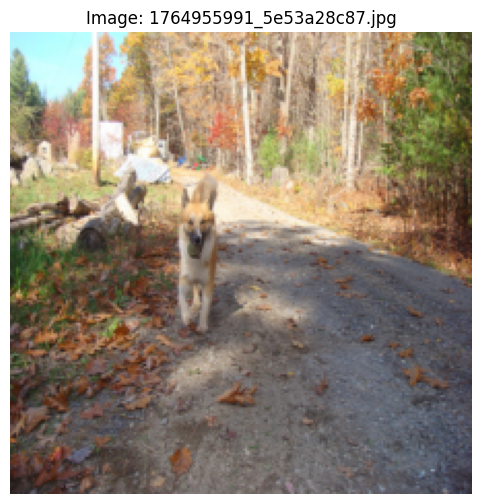


Image 62: 1764955991_5e53a28c87.jpg
Caption générée:
  → a dog jumps over a log in the woods

Vraies captions:
  1. A brown and white dog trotting down the road in autumn .
  2. A brown dog is carrying a ball up the road .
  3. A dog with a ball in his mouth running down a road covered in leaves .
  4. A large dog walks along a gravel path in the woods .
  5. A tan and white dog retrieving a ball on a gravel path .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


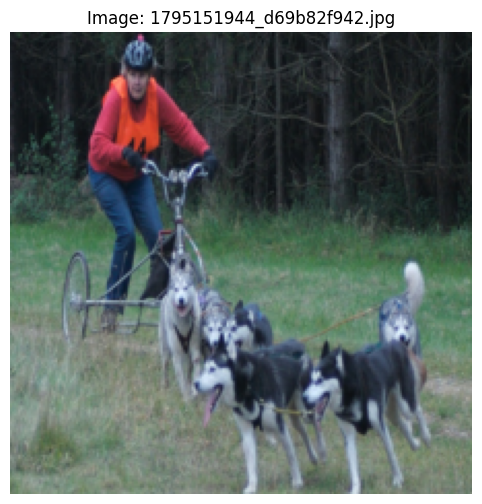


Image 63: 1795151944_d69b82f942.jpg
Caption générée:
  → a greyhound dog is running on the grass

Vraies captions:
  1. A team of dogs , and a woman following on a bike .
  2. A woman is riding a three wheeler bicycle behind a pack of dogs .
  3. A woman on a trike and a team of dogs .
  4. Six huskies are pulling a three wheeled vehicle through the grass .
  5. Woman being pulled on a large tricycle by several sled dogs .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


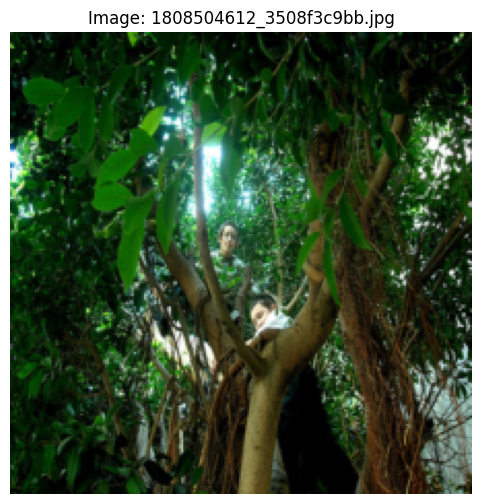


Image 64: 1808504612_3508f3c9bb.jpg
Caption générée:
  → a dog jumps over a bar

Vraies captions:
  1. Children climbing huge tree .
  2. Two children are sitting in some tree branches .
  3. Two children look down from a green tree they have climbed .
  4. Two kids in a green tree .
  5. Two people standing in tree on a sunny day

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


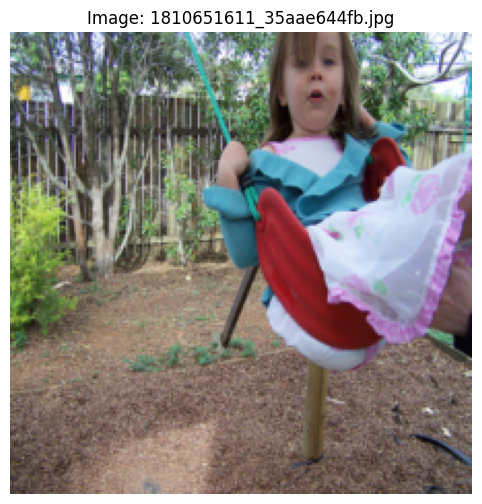


Image 65: 1810651611_35aae644fb.jpg
Caption générée:
  → a little girl in a pink shirt is playing with a toy

Vraies captions:
  1. A closeup of a little girl on a swing .
  2. A little girl in a dress with pink flowers swings on a red-seated swing .
  3. A little girl in a pink and white flowered dress and blue sweater swinging .
  4. A young girl is swinging in a backyard .
  5. The little girl swings in the backyard .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


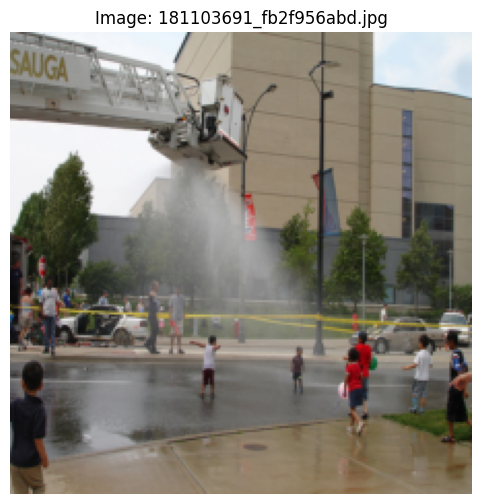


Image 66: 181103691_fb2f956abd.jpg
Caption générée:
  → a man in a black shirt is skateboarding

Vraies captions:
  1. A group of children play in the street where water is sprayed .
  2. Children playing in water .
  3. Children play in the street under a spray of water from a large machine .
  4. Kids playing under a big sprinkler .
  5. Kids play in the water in the middle of the street .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


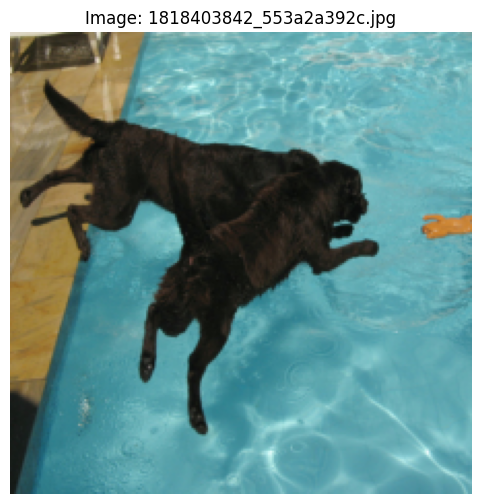


Image 67: 1818403842_553a2a392c.jpg
Caption générée:
  → a dog swims in the water

Vraies captions:
  1. black dogs jump in pool to a hand .
  2. Two black dogs are diving into a pool to get a dog toy .
  3. Two black dogs jump in a pool .
  4. Two black dogs jump into a blue swimming pool .
  5. Two dogs are leaping into a swimming pool trying to fetch the yellow toy that is floating in the water .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


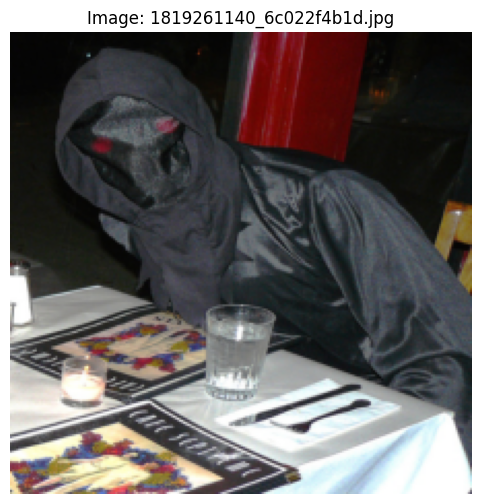


Image 68: 1819261140_6c022f4b1d.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick wall

Vraies captions:
  1. A costumed diner sits in a restaurant wearing a black outfit that covers their face .
  2. A costumed figure leans into the dinner table .
  3. A man dressed in a dark costume sitting at a restaurant table
  4. a man sitting at a table with a scary mask covering his face
  5. A person at a table , dressed in a black costume .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


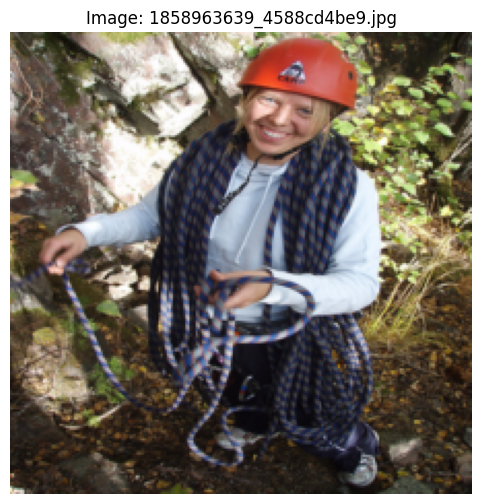


Image 69: 1858963639_4588cd4be9.jpg
Caption générée:
  → a man in a red shirt climbs a rock wall

Vraies captions:
  1. A girl with a red helmet carying a lot of rope .
  2. A smiling woman wearing a red hardhat has a long length of rope around her shoulders .
  3. A woman wearing a red helmet is holding a rope and smiling .
  4. A woman with a helmet and climbing rope smiles at the camera .
  5. The smiling woman in the red helmet is outdoors holding a very long rope .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


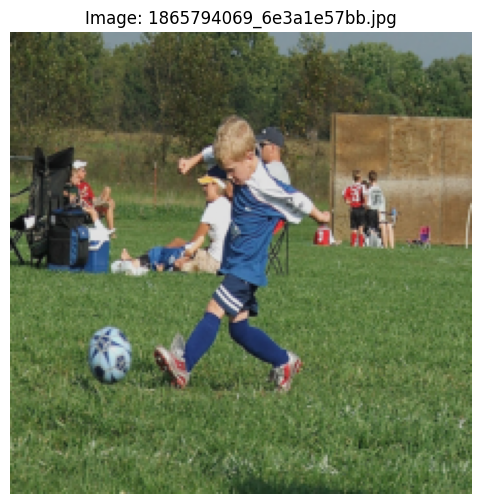


Image 70: 1865794069_6e3a1e57bb.jpg
Caption générée:
  → a little girl in a pink shirt is running on the grass

Vraies captions:
  1. A blond boy with a navy blue uniform kicks a soccer ball in an open field .
  2. A boy in an all blue uniform kicks a blue soccer ball in a grassy area .
  3. A little boy is playing soccer at a field .
  4. A small child plays with a ball while others relax and converse with one another .
  5. A young boy dressed in blue and white is kicking a soccer ball .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


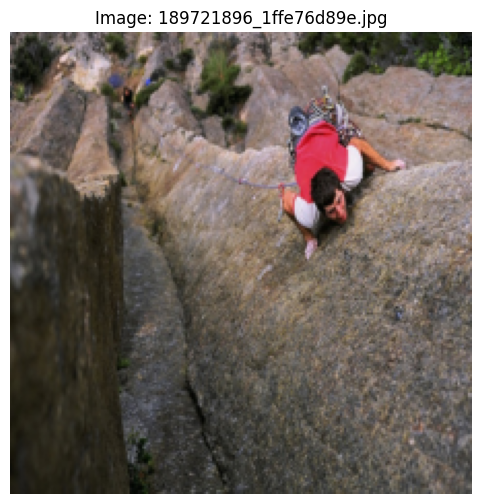


Image 71: 189721896_1ffe76d89e.jpg
Caption générée:
  → a man in a red shirt climbs a rock wall

Vraies captions:
  1. A man rock climbs up a very tall cliff , with a blue rope behind him .
  2. A man wearing a red shirt is climbing up the rock wall .
  3. A young man climbs a mountain , another follows below .
  4. Man scales rock .
  5. The climber in red is leading climbers up a long rock face .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


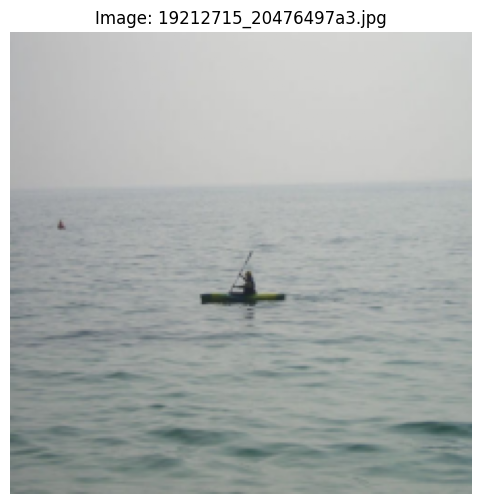


Image 72: 19212715_20476497a3.jpg
Caption générée:
  → a man in a wetsuit is surfing

Vraies captions:
  1. a kayaker kayaks through the water .
  2. A person kayaking in the ocean .
  3. A person kayaks in the middle of the ocean on a grey day .
  4. A person rows a boat over a large body of water .
  5. person in a boat with a paddle in hand

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


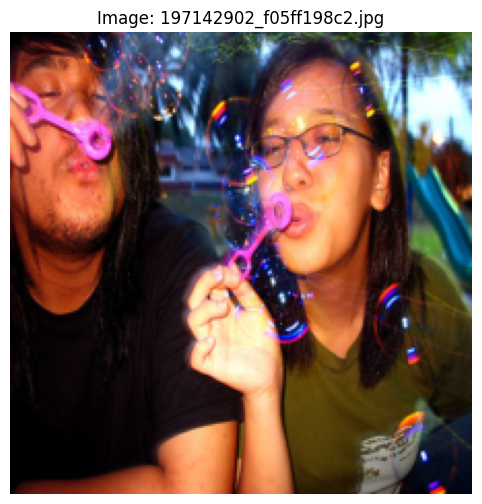


Image 73: 197142902_f05ff198c2.jpg
Caption générée:
  → a woman in a red shirt and a man in a black shirt are standing in front of a brick wall

Vraies captions:
  1. A man and a woman in glasses blow bubbles .
  2. A man and woman blow bubbles .
  3. A man in a black shirt and a woman in a brown shirt blow bubbles with pink wands .
  4. an Asian man and an Asian woman are blowing bubbles from pink plastic hoops .
  5. A woman and man are next to each other blowing bubbles .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


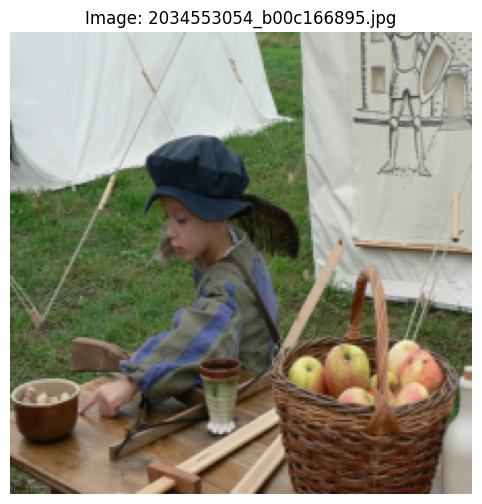


Image 74: 2034553054_b00c166895.jpg
Caption générée:
  → a little girl in a pink shirt is standing in front of a large brick building

Vraies captions:
  1. A boy with a blue hat points towards a bowl full of cork .
  2. A child in medieval clothes points at something on a table .
  3. A child in period costume looking at a table with a bowl , cup , and a basket of apples .
  4. A young boy next to apples at a medieval fair .
  5. The child is sitting at the table with art supplies and apples .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


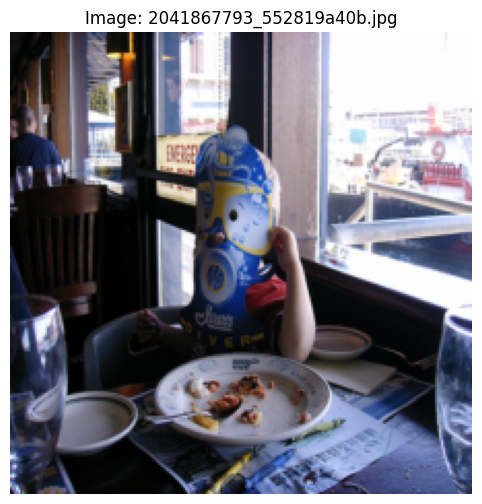


Image 75: 2041867793_552819a40b.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick wall

Vraies captions:
  1. A child sitting at a restaurant table holding a paper mask against his face .
  2. A child with a mask on sitting at a table with a plate in front .
  3. A young child wearing a mask at Ivars .
  4. Child in a restaurant posing with a paper mask
  5. The boy is wearing a cardboard scuba mask at the restaurant .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


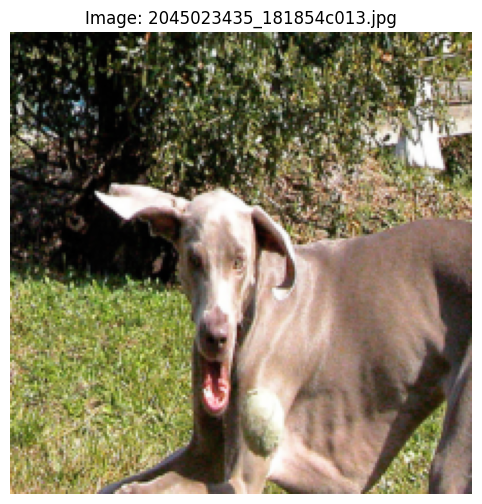


Image 76: 2045023435_181854c013.jpg
Caption générée:
  → a dog is running through a field of grass

Vraies captions:
  1. A brown dog playing with a tennis ball
  2. A brown dog reaches for a tennis ball .
  3. A gray dog is looking at a ball in the air .
  4. A large skinny dog is trying to catch a faded green tennis ball .
  5. Brown dog catches a ball in a sunny yard

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


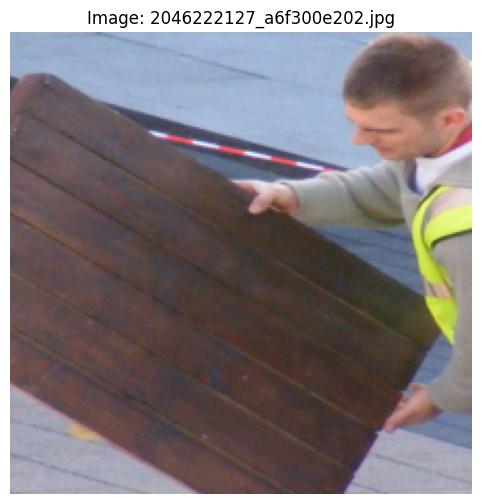


Image 77: 2046222127_a6f300e202.jpg
Caption générée:
  → a little boy in a red shirt is jumping off a wooden platform

Vraies captions:
  1. A man in a neon-colored vest holding up a section of wood
  2. a man in a neon yellow vest carrying a wooden crate
  3. A man in construction gear is moving a large plank of wood to a new destination .
  4. A man wearing yellow hi-viz is grasping a wooden board .
  5. Man with short hair moves wooden structure .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


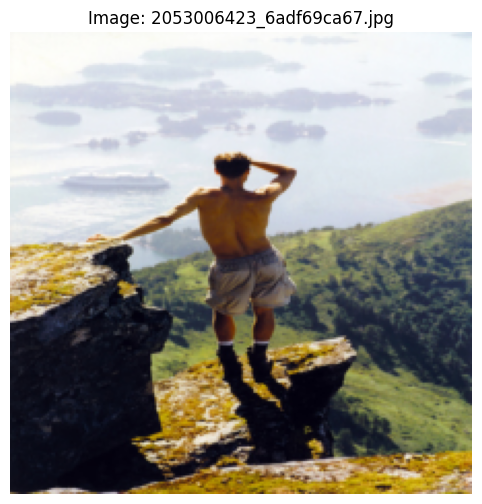


Image 78: 2053006423_6adf69ca67.jpg
Caption générée:
  → a man in a red shirt is climbing a rock wall

Vraies captions:
  1. A man in shorts is standing on a rock looking out at the view from the hilltop .
  2. a man looking at the view of a grassy mountain standing on a rock
  3. A shirtless man standing on a rock overlooking a hillside .
  4. Man with no shirt on wearing shorts and hiking boots standing with hand on his head looking out onto a mountain .
  5. Shirtless man on high cliff with back to camera .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


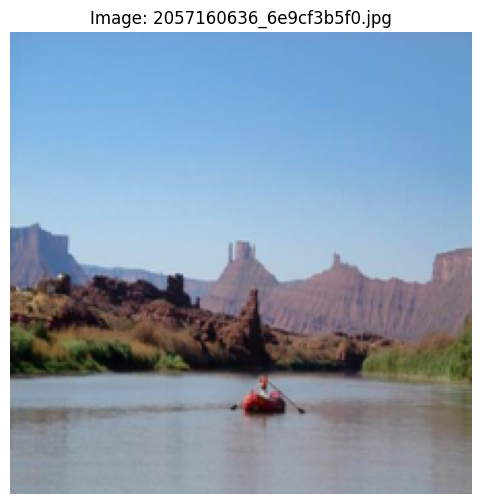


Image 79: 2057160636_6e9cf3b5f0.jpg
Caption générée:
  → a group of people are standing in a river with a mountain range

Vraies captions:
  1. A man paddling in water .
  2. A person paddles a boat on a lake .
  3. Beautiful scenery with a boat on the lake .
  4. Person canoes in lake .
  5. The person is in a conoe and holding a paddle in front of some mountains .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


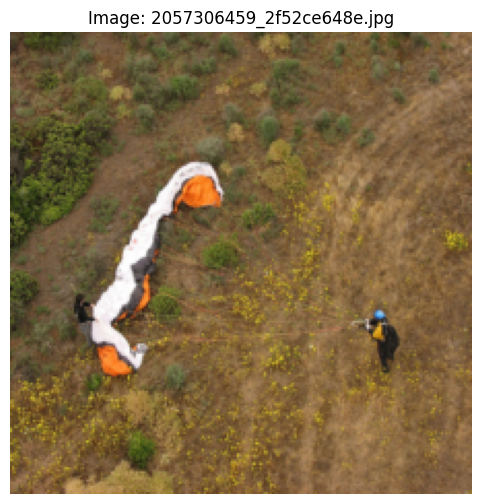


Image 80: 2057306459_2f52ce648e.jpg
Caption générée:
  → a man in a red shirt is riding a bike down a dirt path

Vraies captions:
  1. A person in a field walks toward their white and orange parachute while another holds it .
  2. People collecting a parachute after landing on the ground .
  3. The parachutist is standing in a field near to his unfurled parachute .
  4. Two people fold a parachute after they have landed in a field .
  5. Two people on a grassy plain are gathering a parachute that one of the people just used .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


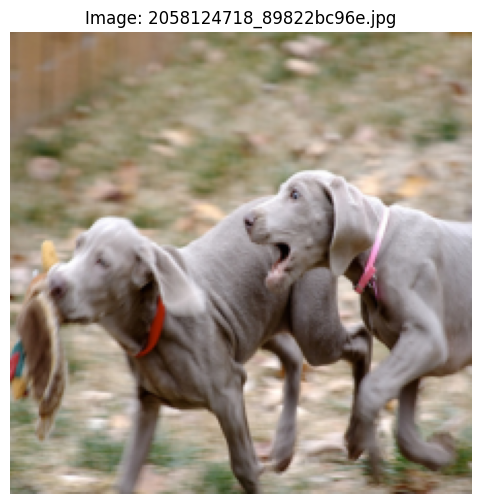


Image 81: 2058124718_89822bc96e.jpg
Caption générée:
  → a dog is running through a grassy field

Vraies captions:
  1. Brown dog barks at another brown dog with a stuffed duck in mouth .
  2. Two bird dogs competing for the kill .
  3. two brown dogs play .
  4. Two dogs running together and one has a duck toy in its mouth .
  5. Two Weirmeiner dogs in red collars are playing with a toy bird

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


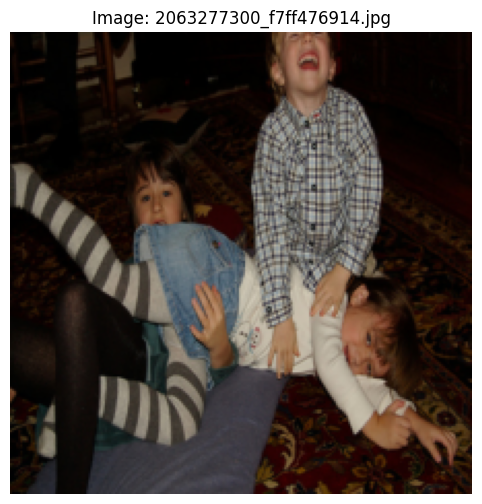


Image 82: 2063277300_f7ff476914.jpg
Caption générée:
  → a little girl in a pink shirt is standing in front of a large bush

Vraies captions:
  1. A little girl in stripped tights lays on the laps of a little girl and boy .
  2. Three children and playing and laughing on the floor .
  3. Three children playing on the floor .
  4. Three children wrestle on a floral carpet .
  5. Three young kids are all tangled up together and playing on a big rug .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


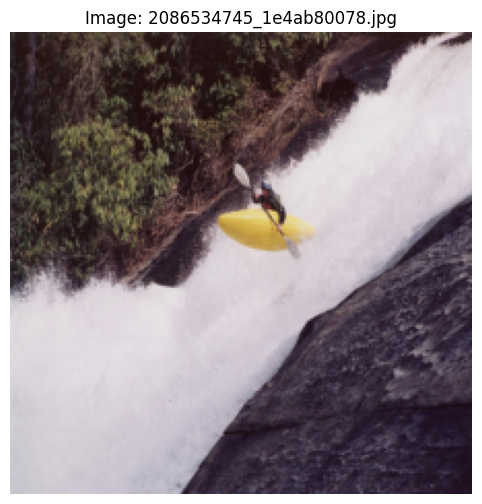


Image 83: 2086534745_1e4ab80078.jpg
Caption générée:
  → a man in a red shirt is snowboarding

Vraies captions:
  1. A man in a yellow boat paddling down rough waters .
  2. A rafter in a yellow raft in a steamy white river .
  3. A yellow kayak is descending quickly down a white water rapid .
  4. Kayacker riding rough current downstream .
  5. The yellow kayak is in the middle of the rapids .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


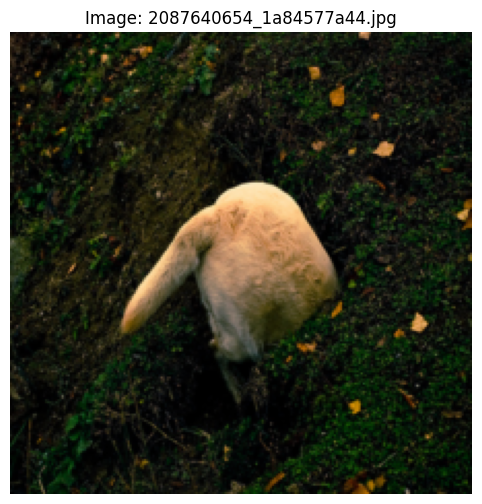


Image 84: 2087640654_1a84577a44.jpg
Caption générée:
  → a dog is running through the grass

Vraies captions:
  1. A blonde dog is digging a deep hole in the ground and its tail is up in the air .
  2. A dog half way in a hole in the ground .
  3. A dog is digging a large hole in a yard to find something .
  4. A dog is digging in the ground and half of his body is under the ground .
  5. The rear end of an animal whose front end is underground .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


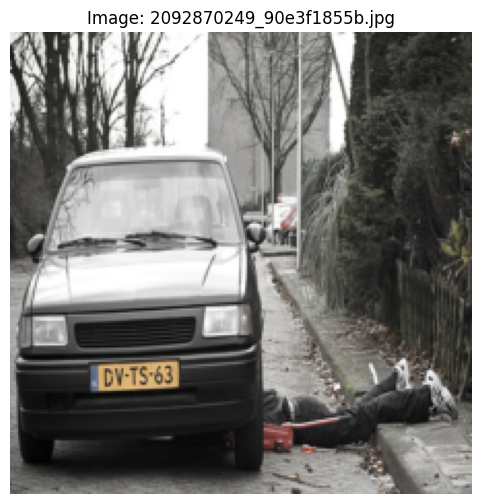


Image 85: 2092870249_90e3f1855b.jpg
Caption générée:
  → a man is standing on a hill overlooking a valley

Vraies captions:
  1. A man lies on a street with his head and shoulders under a parked car that is jacked up .
  2. A man looks under a car on a wet street .
  3. A man works on a car .
  4. A person lies half under a car , face-down .
  5. A person underneath a car with a jack .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


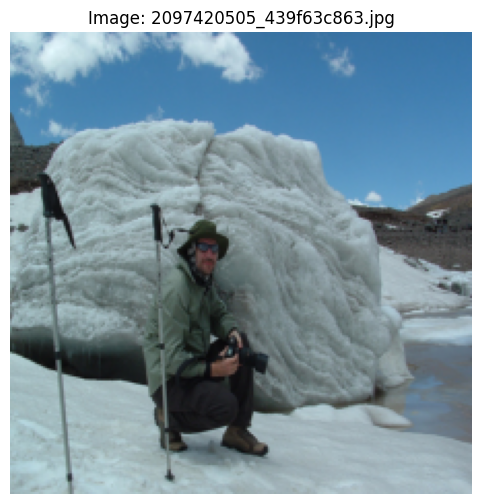


Image 86: 2097420505_439f63c863.jpg
Caption générée:
  → a man in a red shirt is climbing a rock face

Vraies captions:
  1. A male hiker wearing a green jacket is posing next to a large glacier .
  2. A man with a camera and an ice structure behind him .
  3. A man with a camera crouching on ice .
  4. A man with a camera kneels in front of a giant hill of snow .
  5. The mountain climber prepares to take a photo .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


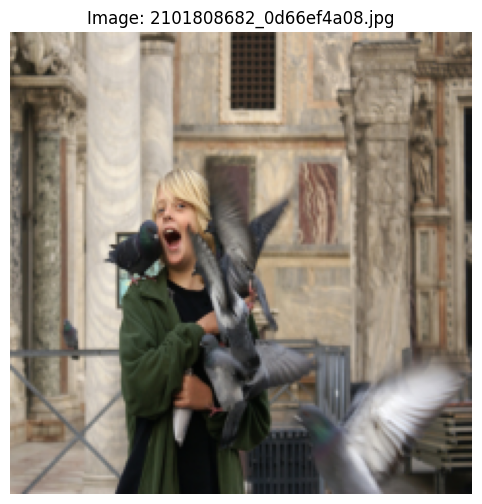


Image 87: 2101808682_0d66ef4a08.jpg
Caption générée:
  → a man and a woman are sitting on a bench

Vraies captions:
  1. A boy being swarmed by pigeons , marble building in the background .
  2. A boy is surrounded by pigeons .
  3. pigeons attack a blonde boy .
  4. Pigeons swarm all over a boy .
  5. There are birds on the boy

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


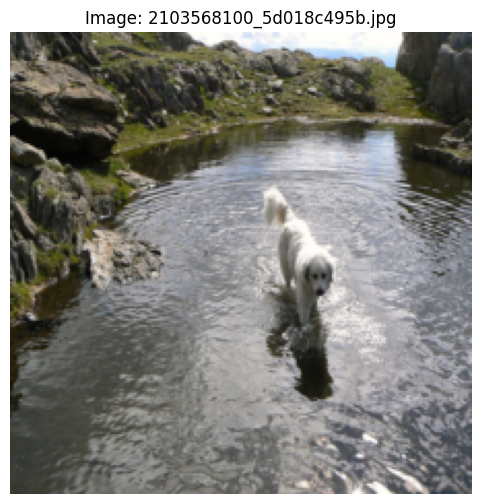


Image 88: 2103568100_5d018c495b.jpg
Caption générée:
  → a black dog is digging in the water

Vraies captions:
  1. A dog in some water enclosed by rocky ledge .
  2. A white dog is standing in a pond .
  3. A white dog is walking through a river that runs through a rocky landscape .
  4. A white dog walks through shallow water in the wilderness .
  5. The white dog is wading in the pond atop the mountain .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


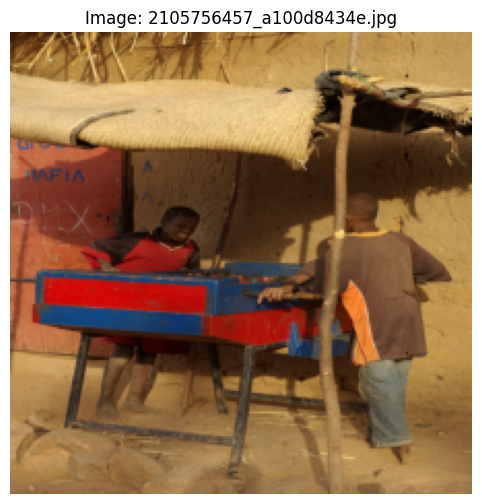


Image 89: 2105756457_a100d8434e.jpg
Caption générée:
  → a man in a black shirt is standing in front of a large brick building

Vraies captions:
  1. Two children standing under an awning .
  2. Two kids are playing a game of Foosball .
  3. Two kids in a developing nation are playing a table top game under an awning made from burlap .
  4. Two men play a game beneath a shade .
  5. Two young kids are in a hut .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


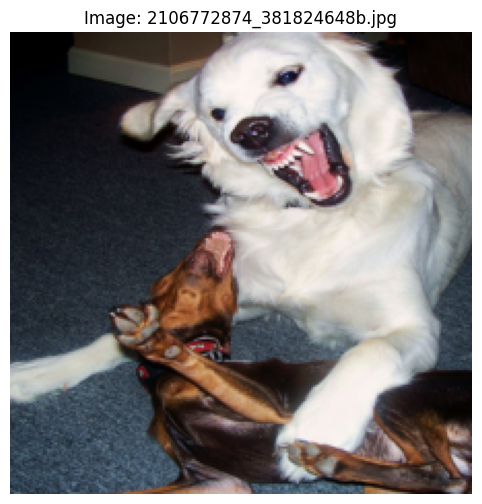


Image 90: 2106772874_381824648b.jpg
Caption générée:
  → a dog is running through a field of grass

Vraies captions:
  1. A brown and black dog and a white dog are wrestling on the carpet .
  2. A large white dog and a smaller brown dog fight .
  3. A white dog opens its mouth near a smaller dog .
  4. A white dog plays with a brown dog on carpet .
  5. Two dogs playing rough .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


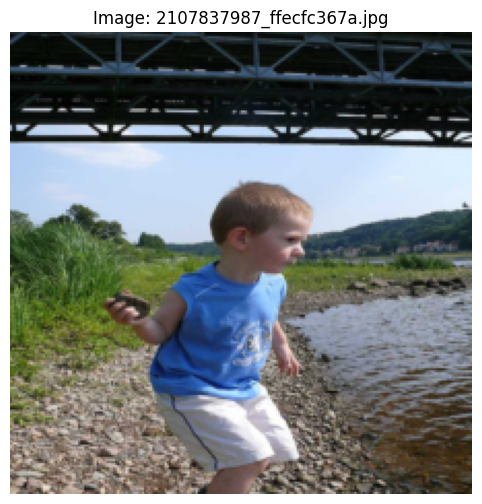


Image 91: 2107837987_ffecfc367a.jpg
Caption générée:
  → a little girl in a pink shirt is walking on a path

Vraies captions:
  1. A boy stands near water with a stone in his hand .
  2. A child in a blue shirt is holding something in his hand on a lake shore .
  3. A little boy is ready to throw a stone into the water .
  4. A skips rocks near a bridge .
  5. The little boy is at the side of the river throwing rocks .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


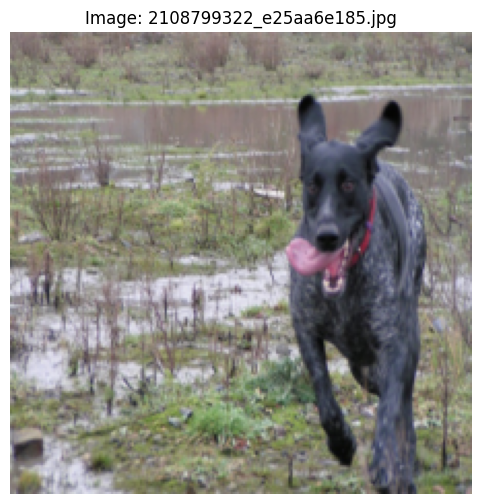


Image 92: 2108799322_e25aa6e185.jpg
Caption générée:
  → a black dog is running through the grass

Vraies captions:
  1. A black dog in running in a field .
  2. A black dog is running through a marsh-like area .
  3. A black dog runs through a muddy bank .
  4. A dog running through mucky ground .
  5. A mostly black short haired dog is running in a swampy area with its tongue out .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


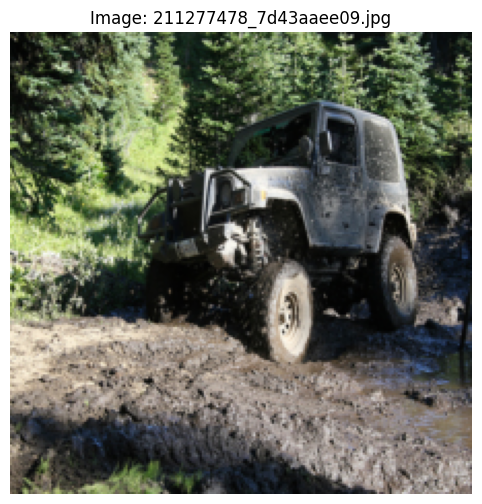


Image 93: 211277478_7d43aaee09.jpg
Caption générée:
  → a person in a red shirt is riding a bike down a dirt path

Vraies captions:
  1. A dirty jeep is stuck in the mud .
  2. A Jeep goes off-roading in the woods with muddy trails making it dirty .
  3. A muddy jeep driving through the forest .
  4. A muddy truck in the woods .
  5. The vehicle is driving through mud surrounded by pine trees .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


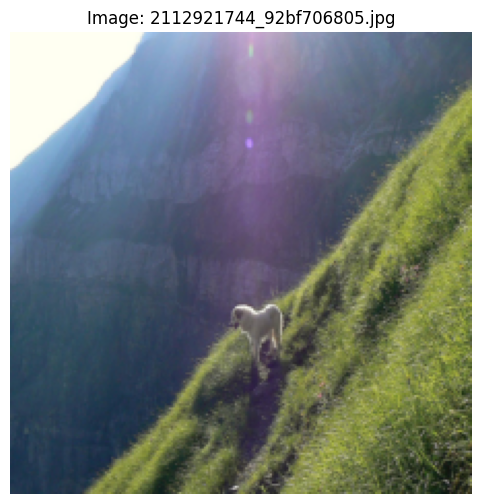


Image 94: 2112921744_92bf706805.jpg
Caption générée:
  → a dog jumps to catch a ball in the air

Vraies captions:
  1. A dog on a green hillside .
  2. A dog standing on the side of a mountain .
  3. A dog stands on the side of a grassy cliff .
  4. A fluffy white dog looks down a steep , grassy embankment .
  5. A white dog is standing on a grassy hillside .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


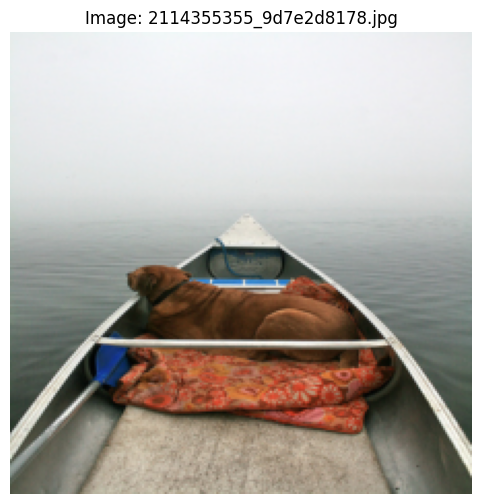


Image 95: 2114355355_9d7e2d8178.jpg
Caption générée:
  → a man in a red shirt is climbing up a rock face

Vraies captions:
  1. A brown dog is sitting in the front of a canoe .
  2. A brown dog lies on a blanket in boat .
  3. A dog lies at the front of a boat headed into the fog .
  4. A Dog lying on a blanket at the end of a small boat .
  5. A reddish-brown dog is laying at the front of a white boat on an orange flowered blanket .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


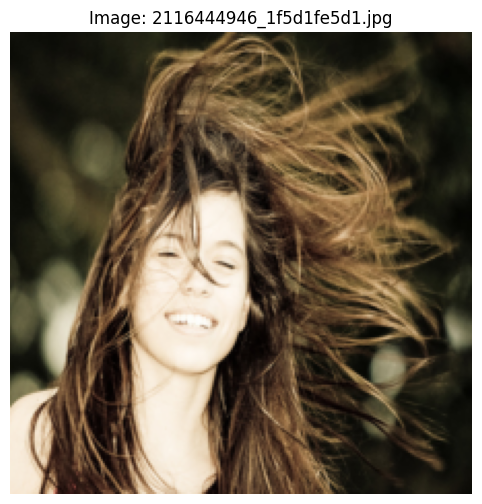


Image 96: 2116444946_1f5d1fe5d1.jpg
Caption générée:
  → a woman with a red bandanna is smiling

Vraies captions:
  1. A girl is standing outdoors with her hair blowing everywhere .
  2. a girl lets her hair blow in the wind .
  3. A girls brown hair is thrashed by the wind .
  4. A smiling young woman is shown from the shoulders up with her long hair blowing in the wind .
  5. Smiling girl with brown hair blowing in air .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


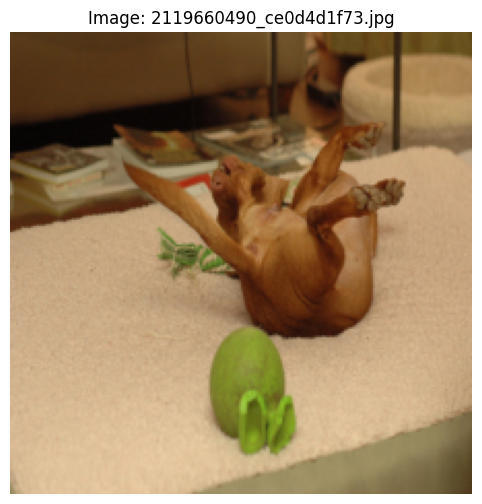


Image 97: 2119660490_ce0d4d1f73.jpg
Caption générée:
  → a dog is jumping over a bar

Vraies captions:
  1. A brown dog is laying on his side on a beige carpet , with a green object in the foreground .
  2. A brown dog is laying on its back on a white carpet with a green ball on it .
  3. A brown dog is rolling on its back on a carpet with several green toys nearby .
  4. A dog lies on its back on a dog bed .
  5. The dog is laying on its back near a green ball .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


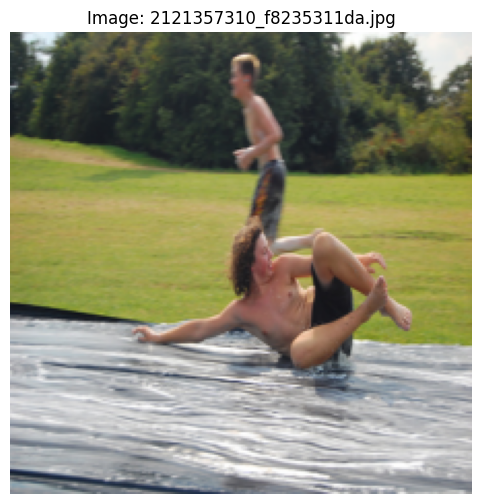


Image 98: 2121357310_f8235311da.jpg
Caption générée:
  → a boy in a red shirt is jumping on a trampoline

Vraies captions:
  1. A boy in a swimsuit slides along a stretch of wet plastic .
  2. A boy slides down a water slide as another boy runs past .
  3. A man in black shorts is sliding on a tarp .
  4. Boy in black shorts sliding on black surface covered with water with green trees in the background .
  5. Boy sliding on a wet plastic surface

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


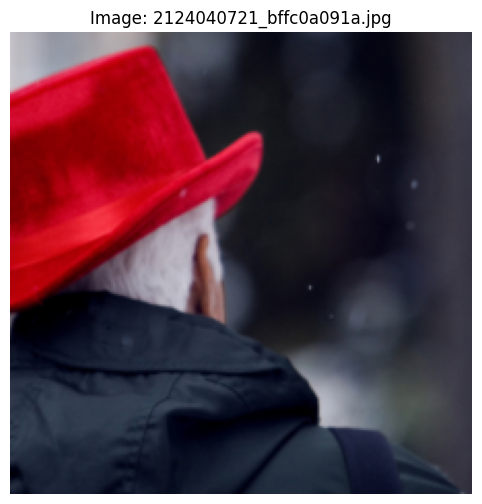


Image 99: 2124040721_bffc0a091a.jpg
Caption générée:
  → a man in a red shirt is standing on a sidewalk with his arms crossed

Vraies captions:
  1. An older man with white hair a blue jacket and a bright red hat .
  2. An old man wearing a red hat and black raincoat .
  3. An old man with white hair in a red hat
  4. A person is a red hat and winter jacket is looking into the distance .
  5. A person with gray hair wears a red hat and watches it snow .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)


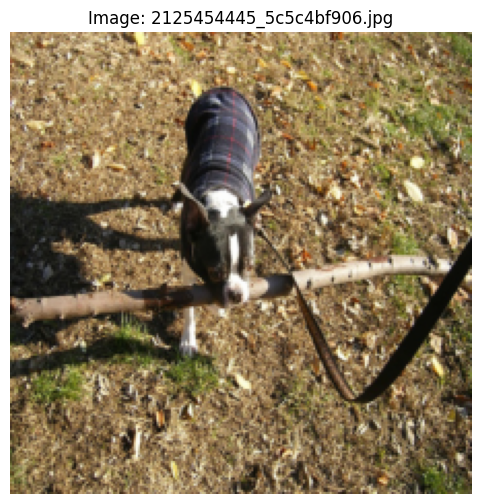


Image 100: 2125454445_5c5c4bf906.jpg
Caption générée:
  → a dog jumps over a bar

Vraies captions:
  1. A black and white dog in a dog-shirt carrying a long piece of wood .
  2. A black and white dog in a plaid coat is carrying a very long stick .
  3. A black and white dog on a leash is wearing a plaid outfit .
  4. A small black and white dog on a leash wearing a shirt carrying a large stick .
  5. A small dog plays with a very big limb .

⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)

✅ Test de génération terminé!


In [26]:
import matplotlib.pyplot as plt

def denormalize_image(tensor):
    """Dénormalise une image pour l'affichage"""
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    img = tensor * std + mean
    img = torch.clamp(img, 0, 1)
    return img

print("="*60)
print("TEST DE GÉNÉRATION DE CAPTIONS - AVEC VÉRIFICATION")
print("="*60)

num_samples = 100
val_df = pd.read_csv(VAL_CAPTIONS, sep=SEPARATOR)
image_groups = val_df.groupby('image')['caption'].apply(list).reset_index()

for i in range(min(num_samples, len(image_groups))):
    image_name = image_groups.iloc[i]['image']
    true_captions = image_groups.iloc[i]['caption']
    
    # Charger le tenseur de l'image
    image_filename = image_name.split('.')[0] + '.pt'
    image_path = Path(VAL_DIR) / image_filename
    
    # ✅ VÉRIFICATION : Le fichier existe-t-il ?
    if not image_path.exists():
        print(f"⚠️ ERREUR: Fichier non trouvé: {image_path}")
        continue
    
    image_tensor = torch.load(image_path)
    
    # ✅ AFFICHER L'IMAGE pour vérifier visuellement
    img_denorm = denormalize_image(image_tensor.cpu())
    img_display = img_denorm.permute(1, 2, 0).numpy()
    
    plt.figure(figsize=(10, 6))
    plt.imshow(img_display)
    plt.axis('off')
    plt.title(f"Image: {image_name}")
    plt.show()
    
    # Générer la caption
    generated_caption = generate_caption(loaded_model, image_tensor, loaded_vocab, device)
    
    print(f"\n{'='*60}")
    print(f"Image {i+1}: {image_name}")
    print(f"{'='*60}")
    print(f"Caption générée:")
    print(f"  → {generated_caption}")
    print(f"\nVraies captions:")
    for j, cap in enumerate(true_captions, 1):
        print(f"  {j}. {cap}")
    
    # ✅ VÉRIFICATION : Regarde l'image et compare avec les captions
    print("\n⚠️ L'image correspond-elle aux vraies captions ? (Regarde visuellement)")
    print("="*60)

print(f"\n{'='*60}")
print("✅ Test de génération terminé!")
print(f"{'='*60}")

In [31]:
import sys
import subprocess
import os

# Créer un dossier pour les packages
packages_dir = '/data1/rbenhsina/Computer vision/VGG DENSE LSTM/packages'
os.makedirs(packages_dir, exist_ok=True)

# Installer pycocoevalcap dans ce dossier
print("📦 Installation de pycocoevalcap...")
subprocess.check_call([
    sys.executable, "-m", "pip", "install", 
    "--target", packages_dir,
    "pycocoevalcap"
])

print("✅ Installation terminée!")

📦 Installation de pycocoevalcap...
  Using cached pycocoevalcap-1.2-py3-none-any.whl (104.3 MB)
  Using cached pycocotools-2.0.10-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (455 kB)
  Using cached numpy-2.2.6-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (16.8 MB)
✅ Installation terminée!


In [32]:
import sys

# Ajouter le dossier au path Python
packages_dir = '/data1/rbenhsina/Computer vision/VGG DENSE LSTM/packages'
if packages_dir not in sys.path:
    sys.path.insert(0, packages_dir)

# Vérifier l'installation
try:
    from pycocoevalcap.bleu.bleu import Bleu
    from pycocoevalcap.meteor.meteor import Meteor
    from pycocoevalcap.rouge.rouge import Rouge
    from pycocoevalcap.cider.cider import Cider
    print("✅ pycocoevalcap importé avec succès !")
except ImportError as e:
    print(f"❌ Erreur d'import : {e}")

✅ pycocoevalcap importé avec succès !


In [36]:
def evaluate_model_metrics(model, vocab, device, val_captions_path, val_dir, separator='|'):
    """
    Calcule BLEU-1, BLEU-2, BLEU-3, BLEU-4, CIDEr, ROUGE_L (sans METEOR)
    """
    
    print("="*60)
    print("CALCUL DES MÉTRIQUES SUR L'ENSEMBLE DE TEST")
    print("="*60)
    
    # Charger les captions de validation
    val_df = pd.read_csv(val_captions_path, sep=separator)
    image_groups = val_df.groupby('image')['caption'].apply(list).reset_index()
    
    # Préparer les dictionnaires
    generated_captions = {}
    reference_captions = {}
    
    print(f"\n📸 Génération des captions pour {len(image_groups)} images...")
    
    model.eval()
    
    for idx in tqdm(range(len(image_groups)), desc="Génération"):
        image_name = image_groups.iloc[idx]['image']
        true_captions = image_groups.iloc[idx]['caption']
        
        # Charger l'image
        image_filename = image_name.split('.')[0] + '.pt'
        image_path = Path(val_dir) / image_filename
        
        if not image_path.exists():
            continue
        
        image_tensor = torch.load(image_path)
        
        # Générer la caption
        generated_caption = generate_caption(model, image_tensor, vocab, device)
        
        img_id = str(idx)
        generated_captions[img_id] = [generated_caption]
        reference_captions[img_id] = true_captions
    
    print(f"\n✅ {len(generated_captions)} captions générées")
    
    # ============================================
    # Calcul des métriques (SANS METEOR)
    # ============================================
    
    print("\n📊 Calcul des métriques...")
    
    scorers = [
        (Bleu(4), ["BLEU-1", "BLEU-2", "BLEU-3", "BLEU-4"]),
        (Rouge(), "ROUGE_L"),
        (Cider(), "CIDEr")
    ]
    
    results = {}
    
    for scorer, method in scorers:
        print(f"  Calcul de {method}...")
        try:
            score, scores = scorer.compute_score(reference_captions, generated_captions)
            
            if isinstance(method, list):
                for m, s in zip(method, score):
                    results[m] = s
            else:
                results[method] = score
        except Exception as e:
            print(f"  ⚠️ Erreur pour {method}: {e}")
            if isinstance(method, list):
                for m in method:
                    results[m] = 0.0
            else:
                results[method] = 0.0
    
    # Ajouter METEOR = N/A
    results['METEOR'] = None
    
    # ============================================
    # Affichage
    # ============================================
    
    print("\n" + "="*60)
    print("📈 RÉSULTATS DES MÉTRIQUES")
    print("="*60)
    
    print(f"\n🔹 BLEU Scores:")
    print(f"  BLEU-1: {results['BLEU-1']:.4f}")
    print(f"  BLEU-2: {results['BLEU-2']:.4f}")
    print(f"  BLEU-3: {results['BLEU-3']:.4f}")
    print(f"  BLEU-4: {results['BLEU-4']:.4f}")
    
    print(f"\n🔹 Autres Métriques:")
    print(f"  METEOR: N/A (erreur Java)")
    print(f"  ROUGE_L: {results['ROUGE_L']:.4f}")
    print(f"  CIDEr: {results['CIDEr']:.4f}")
    
    print("\n" + "="*60)
    
    return results, generated_captions, reference_captions

print("✅ Fonction d'évaluation définie (sans METEOR)!")

✅ Fonction d'évaluation définie (sans METEOR)!


In [37]:
# Calculer les métriques
results, gen_caps, ref_caps = evaluate_model_metrics(
    model=loaded_model,
    vocab=loaded_vocab,
    device=device,
    val_captions_path=TEST_CAPTIONS,
    val_dir=TEST_DIR,
    separator=SEPARATOR
)

# Sauvegarder
import json

results_path = 'outputs/evaluation_metrics.json'
with open(results_path, 'w') as f:
    json.dump(results, f, indent=4)

print(f"\n💾 Résultats sauvegardés: {results_path}")

CALCUL DES MÉTRIQUES SUR L'ENSEMBLE DE TEST

📸 Génération des captions pour 810 images...


Génération: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 810/810 [00:02<00:00, 333.82it/s]



✅ 810 captions générées

📊 Calcul des métriques...
  Calcul de ['BLEU-1', 'BLEU-2', 'BLEU-3', 'BLEU-4']...
{'testlen': 9266, 'reflen': 9180, 'guess': [9266, 8456, 7646, 6836], 'correct': [4289, 1447, 458, 151]}
ratio: 1.0093681917210229
  Calcul de ROUGE_L...
  Calcul de CIDEr...

📈 RÉSULTATS DES MÉTRIQUES

🔹 BLEU Scores:
  BLEU-1: 0.4629
  BLEU-2: 0.2814
  BLEU-3: 0.1680
  BLEU-4: 0.1012

🔹 Autres Métriques:
  METEOR: N/A (erreur Java)
  ROUGE_L: 0.3158
  CIDEr: 0.2254


💾 Résultats sauvegardés: outputs/evaluation_metrics.json
